<a href="https://colab.research.google.com/github/Priyanshiguptaaa/CS5787-DeepLearning-Assignment3/blob/main/dl_ass3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import zipfile
import os
import gzip
import shutil
from google.colab import drive
import numpy as np

input_folder = '/content/drive/MyDrive/fmnist'

train_img_path = os.path.join(input_folder, 'train-images-idx3-ubyte.gz')
train_labels_path = os.path.join(input_folder, 'train-labels-idx1-ubyte.gz')
test_img_path = os.path.join(input_folder, 't10k-images-idx3-ubyte.gz')
test_labels_path = os.path.join(input_folder, 't10k-labels-idx1-ubyte.gz')

def read_image_file(filename):
    with gzip.open(filename, 'rb') as f:
        # Skip the magic number and dimensions (first 16 bytes)
        f.read(16)
        # Read the image data into a NumPy array
        return np.frombuffer(f.read(), dtype=np.uint8).reshape(-1, 28, 28)  # 28x28 is the dimension of MNIST/Fashion-MNIST images

# Function to read labels from the gzipped files
def read_label_file(filename):
    with gzip.open(filename, 'rb') as f:
        # Skip the magic number (first 8 bytes)
        f.read(8)
        # Read the label data into a NumPy array
        return np.frombuffer(f.read(), dtype=np.uint8)

# Read gzipped image and label data
train_imgs = read_image_file(train_img_path)
train_labels = read_label_file(train_labels_path)
test_imgs = read_image_file(test_img_path)
test_labels = read_label_file(test_labels_path)

In [ ]:
print(f"Train Images: {train_imgs.shape}")
print(f"Train Labels: {train_labels.shape}")
print(f"Test Images: {test_imgs.shape}")
print(f"Test Labels: {test_labels.shape}")

Train Images: (60000, 28, 28)
Train Labels: (60000,)
Test Images: (10000, 28, 28)
Test Labels: (10000,)


In [ ]:
import torch
from torch.utils.data import TensorDataset, DataLoader

train_imgs = train_imgs / 255.0
test_imgs = test_imgs / 255.0

# Step 1: Convert numpy arrays to PyTorch tensors
X_train_tensor = torch.tensor(train_imgs, dtype=torch.float32)  # Convert images to float32
y_train_tensor = torch.tensor(train_labels, dtype=torch.long)   # Convert labels to long for classification
X_test_tensor = torch.tensor(test_imgs, dtype=torch.float32)    # Convert images to float32
y_test_tensor = torch.tensor(test_labels, dtype=torch.long)     # Convert labels to long for classification

# Step 2: Reshape the tensors to fit into a model expecting (batch_size, 1, 28, 28)
X_train_tensor = X_train_tensor.view(-1, 1, 28, 28)
X_test_tensor = X_test_tensor.view(-1, 1, 28, 28)

# Step 3: Create TensorDataset for both training and testing sets
train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
test_dataset = TensorDataset(X_test_tensor, y_test_tensor)

# Step 4: Create DataLoaders
train_loader = DataLoader(train_dataset, batch_size=100, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=100, shuffle=False)

# Check if CUDA is available and use GPU if possible
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
print(X_train_tensor.shape)
print(X_test_tensor.shape)

torch.Size([60000, 1, 28, 28])
torch.Size([10000, 1, 28, 28])


# Variational AutoEncoder

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class VAE(nn.Module):
    def __init__(self, input_dim=784, hidden_dim=500, latent_dim=50):
        super(VAE, self).__init__()

        # Encoder layers
        self.fc1 = nn.Linear(input_dim, hidden_dim)
        self.fc_mu = nn.Linear(hidden_dim, latent_dim)  # Mean of the latent space
        self.fc_logvar = nn.Linear(hidden_dim, latent_dim)  # Log variance of the latent space

        # Decoder layers
        self.fc3 = nn.Linear(latent_dim, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, input_dim)

    def encode(self, x):
        h1 = F.relu(self.fc1(x))  # Fully connected layer with ReLU activation
        mu = self.fc_mu(h1)  # Predict mean
        logvar = self.fc_logvar(h1)  # Predict log variance
        return mu, logvar

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)  # Calculate standard deviation
        eps = torch.randn_like(std)  # Sample random noise
        return mu + eps * std  # Reparameterization trick

    def decode(self, z):
        h3 = F.relu(self.fc3(z))  # Apply ReLU to the first decoder layer
        return torch.sigmoid(self.fc4(h3))  # Sigmoid output for reconstruction

    def forward(self, x):
        mu, logvar = self.encode(x.view(-1, 784))  # Flatten the input and encode
        z = self.reparameterize(mu, logvar)  # Reparameterize to get latent variable z
        return self.decode(z), mu, logvar  # Decode and return reconstructions, mu, and logvar

def vae_loss_function(recon_x, x, mu, logvar):
    # Reconstruction loss (Binary Cross-Entropy)
    BCE = F.binary_cross_entropy(recon_x, x.view(-1, 784), reduction='sum')

    # KL divergence loss
    KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

    return BCE + KLD


In [ ]:
import torch.optim as optim
from tqdm import tqdm

# Hyperparameters based on the paper
latent_dim = 50  # Latent space size as per the paper
hidden_dim = 500  # Fully connected layer size
input_dim = 784  # MNIST images are 28x28, so flattened size is 784
num_epochs = 50
batch_size = 100
learning_rate = 1e-3

# Initialize the model and optimizer
model = VAE(input_dim=input_dim, hidden_dim=hidden_dim, latent_dim=latent_dim).to(device)
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

# Training loop
for epoch in range(num_epochs):
    model.train()  # Set the model to training mode
    train_loss = 0

    # Training phase
    for batch_X, _ in tqdm(train_loader):
        batch_X = batch_X.to(device)  # Move to device (GPU or CPU)
        optimizer.zero_grad()  # Zero out gradients

        # Forward pass
        recon_batch, mu, logvar = model(batch_X)

        # Compute VAE loss
        loss = vae_loss_function(recon_batch, batch_X, mu, logvar)

        # Backward pass and optimization
        loss.backward()
        train_loss += loss.item()
        optimizer.step()

    avg_train_loss = train_loss / len(train_loader.dataset)

    # Validation phase
    model.eval()  # Set the model to evaluation mode
    val_loss = 0
    with torch.no_grad():  # Disable gradient calculation for validation
        for batch_X, _ in test_loader:  # Assuming test_loader acts as your validation loader
            batch_X = batch_X.to(device)

            # Forward pass (no backpropagation here)
            recon_batch, mu, logvar = model(batch_X)

            # Compute VAE loss
            loss = vae_loss_function(recon_batch, batch_X, mu, logvar)
            val_loss += loss.item()

    avg_val_loss = val_loss / len(test_loader.dataset)

    # Print training and validation loss
    print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {avg_train_loss:.6f}, Val Loss: {avg_val_loss:.6f}')

100%|██████████| 600/600 [00:03<00:00, 157.92it/s]


Epoch [1/50], Train Loss: 285.023340, Val Loss: 265.601919


100%|██████████| 600/600 [00:02<00:00, 261.22it/s]


Epoch [2/50], Train Loss: 257.195742, Val Loss: 253.907405


100%|██████████| 600/600 [00:02<00:00, 211.83it/s]


Epoch [3/50], Train Loss: 250.063514, Val Loss: 249.957545


100%|██████████| 600/600 [00:02<00:00, 289.08it/s]


Epoch [4/50], Train Loss: 247.184451, Val Loss: 247.759028


100%|██████████| 600/600 [00:02<00:00, 288.85it/s]


Epoch [5/50], Train Loss: 245.508992, Val Loss: 246.756843


100%|██████████| 600/600 [00:02<00:00, 289.90it/s]


Epoch [6/50], Train Loss: 244.458866, Val Loss: 245.545310


100%|██████████| 600/600 [00:02<00:00, 292.30it/s]


Epoch [7/50], Train Loss: 243.682909, Val Loss: 245.016093


100%|██████████| 600/600 [00:02<00:00, 231.92it/s]


Epoch [8/50], Train Loss: 243.077678, Val Loss: 245.049918


100%|██████████| 600/600 [00:03<00:00, 190.58it/s]


Epoch [9/50], Train Loss: 242.504561, Val Loss: 244.165029


100%|██████████| 600/600 [00:02<00:00, 233.35it/s]


Epoch [10/50], Train Loss: 242.066574, Val Loss: 243.640352


100%|██████████| 600/600 [00:02<00:00, 293.27it/s]


Epoch [11/50], Train Loss: 241.613601, Val Loss: 243.242102


100%|██████████| 600/600 [00:02<00:00, 286.07it/s]


Epoch [12/50], Train Loss: 241.339666, Val Loss: 242.737552


100%|██████████| 600/600 [00:02<00:00, 286.75it/s]


Epoch [13/50], Train Loss: 240.947666, Val Loss: 242.736336


100%|██████████| 600/600 [00:02<00:00, 222.99it/s]


Epoch [14/50], Train Loss: 240.753136, Val Loss: 242.788940


100%|██████████| 600/600 [00:02<00:00, 254.20it/s]


Epoch [15/50], Train Loss: 240.531441, Val Loss: 242.155937


100%|██████████| 600/600 [00:02<00:00, 289.12it/s]


Epoch [16/50], Train Loss: 240.341127, Val Loss: 242.260553


100%|██████████| 600/600 [00:02<00:00, 290.77it/s]


Epoch [17/50], Train Loss: 240.123661, Val Loss: 241.930693


100%|██████████| 600/600 [00:02<00:00, 292.93it/s]


Epoch [18/50], Train Loss: 239.992005, Val Loss: 241.669734


100%|██████████| 600/600 [00:02<00:00, 281.92it/s]


Epoch [19/50], Train Loss: 239.913147, Val Loss: 241.502701


100%|██████████| 600/600 [00:02<00:00, 210.64it/s]


Epoch [20/50], Train Loss: 239.708322, Val Loss: 241.535483


100%|██████████| 600/600 [00:02<00:00, 288.23it/s]


Epoch [21/50], Train Loss: 239.639484, Val Loss: 241.538040


100%|██████████| 600/600 [00:02<00:00, 294.55it/s]


Epoch [22/50], Train Loss: 239.510783, Val Loss: 241.359896


100%|██████████| 600/600 [00:02<00:00, 298.80it/s]


Epoch [23/50], Train Loss: 239.398670, Val Loss: 241.499907


100%|██████████| 600/600 [00:02<00:00, 293.20it/s]


Epoch [24/50], Train Loss: 239.311426, Val Loss: 241.207779


100%|██████████| 600/600 [00:02<00:00, 261.51it/s]


Epoch [25/50], Train Loss: 239.203963, Val Loss: 241.064487


100%|██████████| 600/600 [00:02<00:00, 220.98it/s]


Epoch [26/50], Train Loss: 239.100791, Val Loss: 241.146974


100%|██████████| 600/600 [00:02<00:00, 290.85it/s]


Epoch [27/50], Train Loss: 239.057135, Val Loss: 241.034771


100%|██████████| 600/600 [00:02<00:00, 292.50it/s]


Epoch [28/50], Train Loss: 238.968313, Val Loss: 241.085546


100%|██████████| 600/600 [00:02<00:00, 288.55it/s]


Epoch [29/50], Train Loss: 238.895601, Val Loss: 241.150933


100%|██████████| 600/600 [00:02<00:00, 294.64it/s]


Epoch [30/50], Train Loss: 238.813092, Val Loss: 241.010280


100%|██████████| 600/600 [00:02<00:00, 234.22it/s]


Epoch [31/50], Train Loss: 238.783752, Val Loss: 240.632345


100%|██████████| 600/600 [00:02<00:00, 238.83it/s]


Epoch [32/50], Train Loss: 238.685984, Val Loss: 240.745060


100%|██████████| 600/600 [00:02<00:00, 286.39it/s]


Epoch [33/50], Train Loss: 238.635418, Val Loss: 240.667056


100%|██████████| 600/600 [00:02<00:00, 284.83it/s]


Epoch [34/50], Train Loss: 238.600713, Val Loss: 240.499802


100%|██████████| 600/600 [00:02<00:00, 290.58it/s]


Epoch [35/50], Train Loss: 238.524987, Val Loss: 240.793001


100%|██████████| 600/600 [00:02<00:00, 277.93it/s]


Epoch [36/50], Train Loss: 238.478180, Val Loss: 240.894191


100%|██████████| 600/600 [00:02<00:00, 211.41it/s]


Epoch [37/50], Train Loss: 238.442973, Val Loss: 240.497033


100%|██████████| 600/600 [00:02<00:00, 285.40it/s]


Epoch [38/50], Train Loss: 238.406009, Val Loss: 240.626708


100%|██████████| 600/600 [00:02<00:00, 290.33it/s]


Epoch [39/50], Train Loss: 238.364348, Val Loss: 240.641735


100%|██████████| 600/600 [00:02<00:00, 281.58it/s]


Epoch [40/50], Train Loss: 238.357565, Val Loss: 240.519318


100%|██████████| 600/600 [00:02<00:00, 296.08it/s]


Epoch [41/50], Train Loss: 238.259584, Val Loss: 240.315621


100%|██████████| 600/600 [00:02<00:00, 247.94it/s]


Epoch [42/50], Train Loss: 238.264672, Val Loss: 240.351983


100%|██████████| 600/600 [00:02<00:00, 226.43it/s]


Epoch [43/50], Train Loss: 238.193713, Val Loss: 240.365804


100%|██████████| 600/600 [00:02<00:00, 289.70it/s]


Epoch [44/50], Train Loss: 238.150018, Val Loss: 240.374765


100%|██████████| 600/600 [00:02<00:00, 288.65it/s]


Epoch [45/50], Train Loss: 238.144400, Val Loss: 240.226740


100%|██████████| 600/600 [00:02<00:00, 294.39it/s]


Epoch [46/50], Train Loss: 238.083280, Val Loss: 240.275121


100%|██████████| 600/600 [00:02<00:00, 291.62it/s]


Epoch [47/50], Train Loss: 238.057356, Val Loss: 240.196571


100%|██████████| 600/600 [00:02<00:00, 234.74it/s]


Epoch [48/50], Train Loss: 238.050213, Val Loss: 240.208806


100%|██████████| 600/600 [00:02<00:00, 238.98it/s]


Epoch [49/50], Train Loss: 237.995901, Val Loss: 240.133269


100%|██████████| 600/600 [00:02<00:00, 293.12it/s]


Epoch [50/50], Train Loss: 237.941877, Val Loss: 240.279763


In [ ]:
import numpy as np
from sklearn import svm
from sklearn.metrics import accuracy_score

# Function to extract latent space representation
def extract_latent_features(model, data_loader):
    model.eval()  # Set the model to evaluation mode
    latent_features = []
    labels = []

    with torch.no_grad():
        for batch_X, batch_y in data_loader:
            batch_X = batch_X.to(device)
            mu, _ = model.encode(batch_X.view(-1, 784))  # Only take mu (latent representation)
            latent_features.append(mu.cpu().numpy())
            labels.append(batch_y.cpu().numpy())

    return np.concatenate(latent_features), np.concatenate(labels)

# Assume `train_loader` and `test_loader` are already defined for loading data.

# Extract latent features from the training set (full labeled data)
X_train_latent, y_train_latent = extract_latent_features(model, train_loader)

# Extract latent features from the test set
X_test_latent, y_test_latent = extract_latent_features(model, test_loader)

num_labels = 100  # Change this to 600, 1000, or 3000 as needed
X_train_latent_subset = X_train_latent[:num_labels]
y_train_latent_subset = y_train_latent[:num_labels]

svm_classifier = svm.SVC(kernel='linear')
# Train the SVM with the subset
svm_classifier.fit(X_train_latent_subset, y_train_latent_subset)

# Test on the full test set
y_test_pred = svm_classifier.predict(X_test_latent)

# Calculate accuracy for the subset-trained SVM
accuracy = accuracy_score(y_test_latent, y_test_pred)
print(f"Test Accuracy with {num_labels} labels: {accuracy * 100:.2f}%")

Test Accuracy with 100 labels: 60.13%


In [ ]:
num_labels = 600  # Change this to 600, 1000, or 3000 as needed
X_train_latent_subset = X_train_latent[:num_labels]
y_train_latent_subset = y_train_latent[:num_labels]

svm_classifier = svm.SVC(kernel='linear')
# Train the SVM with the subset
svm_classifier.fit(X_train_latent_subset, y_train_latent_subset)

# Test on the full test set
y_test_pred = svm_classifier.predict(X_test_latent)

# Calculate accuracy for the subset-trained SVM
accuracy = accuracy_score(y_test_latent, y_test_pred)
print(f"Test Accuracy with {num_labels} labels: {accuracy * 100:.2f}%")

Test Accuracy with 600 labels: 76.14%


In [ ]:
num_labels = 1000  # Change this to 600, 1000, or 3000 as needed
X_train_latent_subset = X_train_latent[:num_labels]
y_train_latent_subset = y_train_latent[:num_labels]

svm_classifier = svm.SVC(kernel='linear')
# Train the SVM with the subset
svm_classifier.fit(X_train_latent_subset, y_train_latent_subset)

# Test on the full test set
y_test_pred = svm_classifier.predict(X_test_latent)

# Calculate accuracy for the subset-trained SVM
accuracy = accuracy_score(y_test_latent, y_test_pred)
print(f"Test Accuracy with {num_labels} labels: {accuracy * 100:.2f}%")

Test Accuracy with 1000 labels: 77.91%


In [ ]:
num_labels = 3000  # Change this to 600, 1000, or 3000 as needed
X_train_latent_subset = X_train_latent[:num_labels]
y_train_latent_subset = y_train_latent[:num_labels]

svm_classifier = svm.SVC(kernel='linear')
# Train the SVM with the subset
svm_classifier.fit(X_train_latent_subset, y_train_latent_subset)

# Test on the full test set
y_test_pred = svm_classifier.predict(X_test_latent)

# Calculate accuracy for the subset-trained SVM
accuracy = accuracy_score(y_test_latent, y_test_pred)
print(f"Test Accuracy with {num_labels} labels: {accuracy * 100:.2f}%")

Test Accuracy with 3000 labels: 80.28%


# GAN

# Data

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import torchvision  # Import for make_grid
from tqdm import tqdm

# Data loading
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

batch_size=64

fashion_mnist = datasets.FashionMNIST(root='data/', train=True, transform=transform, download=True)
data_loader = DataLoader(fashion_mnist, batch_size=batch_size, shuffle=True)

100%|██████████| 26421880/26421880 [00:03<00:00, 8567505.01it/s] 


Extracting data/FashionMNIST/raw/train-images-idx3-ubyte.gz to data/FashionMNIST/raw



100%|██████████| 29515/29515 [00:00<00:00, 173732.33it/s]


Extracting data/FashionMNIST/raw/train-labels-idx1-ubyte.gz to data/FashionMNIST/raw



100%|██████████| 4422102/4422102 [00:01<00:00, 3238488.00it/s]


Extracting data/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to data/FashionMNIST/raw



100%|██████████| 5148/5148 [00:00<00:00, 8169609.15it/s]

Extracting data/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to data/FashionMNIST/raw



# Architecture 1

In [6]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Generator
class Architecture_1_Generator(nn.Module):
    def __init__(self):
        super(Architecture_1_Generator, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(100, 128, 7, 1, 0, bias=False),
            nn.LeakyReLU(0.3),
            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.3),
            nn.ConvTranspose2d(64, 1, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, z):
        z = z.view(-1, 100, 1, 1)  # Reshape for ConvTranspose2d
        return self.model(z)

# Discriminator
class Architecture_1_Discriminator(nn.Module):
    def __init__(self):
        super(Architecture_1_Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(1, 64, 4, 2, 1, bias=False),
            nn.ReLU(),
            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.ReLU(),
            nn.Conv2d(128, 1, 7, 1, 0, bias=False),
            nn.Sigmoid()  # Apply Sigmoid to ensure output is between 0 and 1
        )

    def forward(self, img):
        return self.model(img).view(-1, 1)  # Reshape to (batch_size, 1)

## DCGAN

In [9]:
import os
output_dir = 'output'
os.makedirs(output_dir, exist_ok=True)

Epoch [1/50]: 100%|██████████| 938/938 [01:07<00:00, 13.82batch/s, d_loss=0.242, g_loss=3.69]


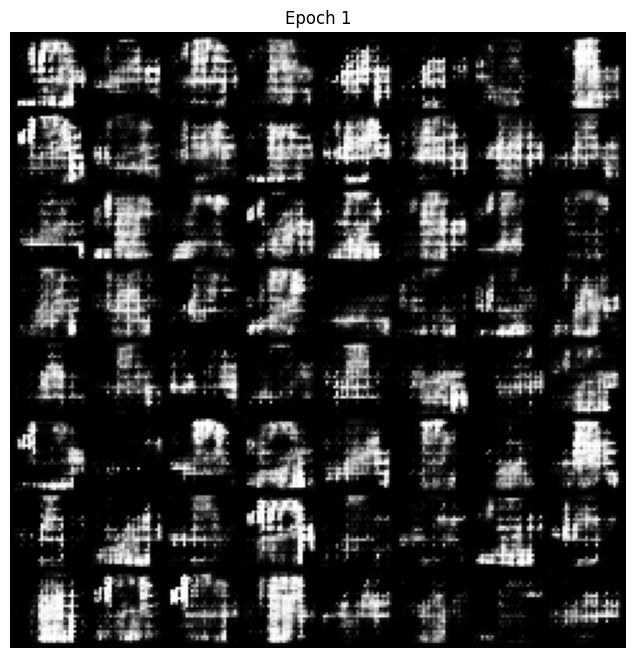

Epoch [2/50]: 100%|██████████| 938/938 [01:09<00:00, 13.50batch/s, d_loss=0.505, g_loss=3.59]


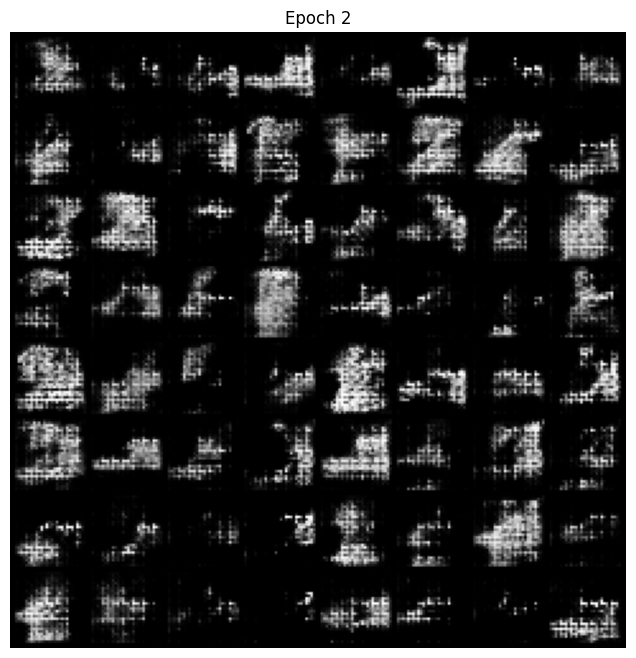

Epoch [3/50]: 100%|██████████| 938/938 [01:06<00:00, 14.06batch/s, d_loss=0.216, g_loss=3.09]


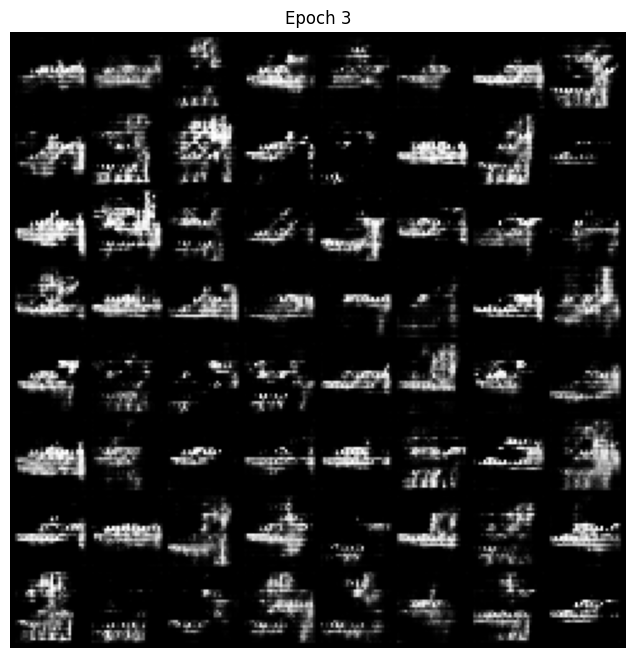

Epoch [4/50]: 100%|██████████| 938/938 [01:05<00:00, 14.25batch/s, d_loss=0.856, g_loss=2.66]


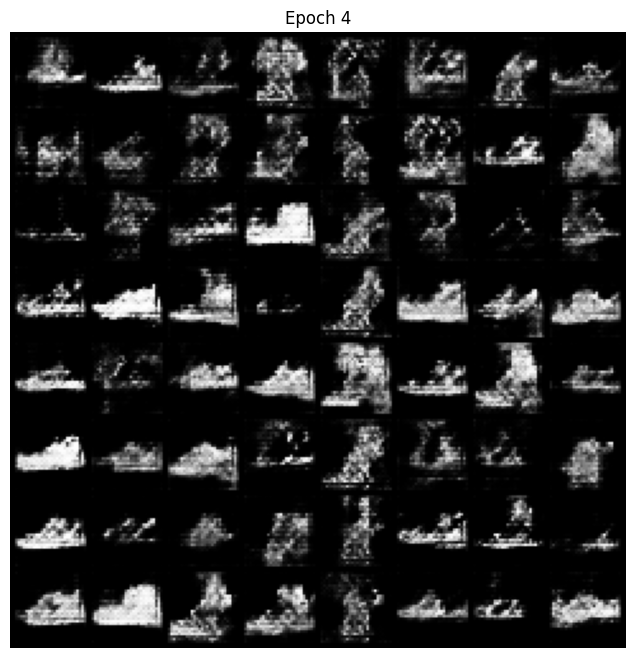

Epoch [5/50]: 100%|██████████| 938/938 [01:05<00:00, 14.35batch/s, d_loss=0.43, g_loss=2.7]


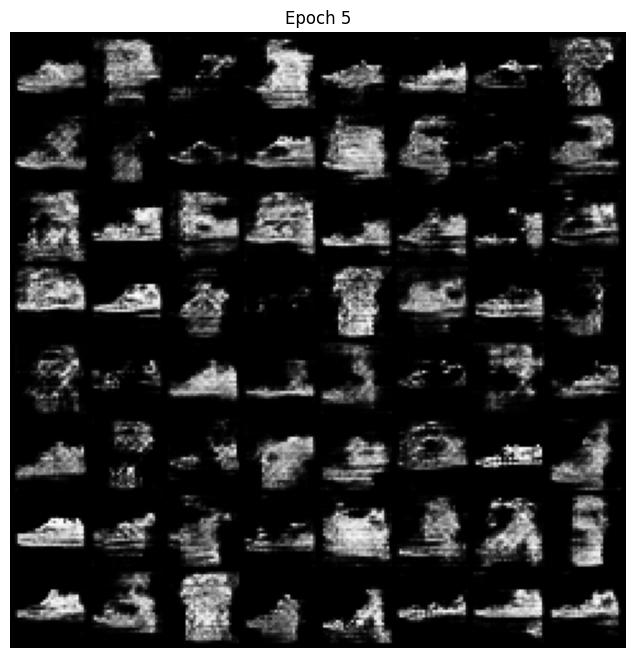

Epoch [6/50]: 100%|██████████| 938/938 [01:05<00:00, 14.24batch/s, d_loss=0.278, g_loss=3.13]


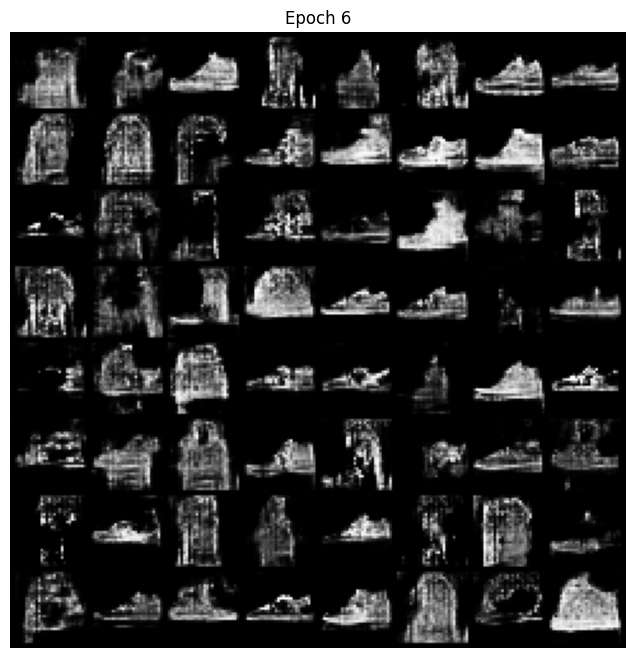

Epoch [7/50]: 100%|██████████| 938/938 [01:07<00:00, 14.00batch/s, d_loss=0.568, g_loss=2.96]


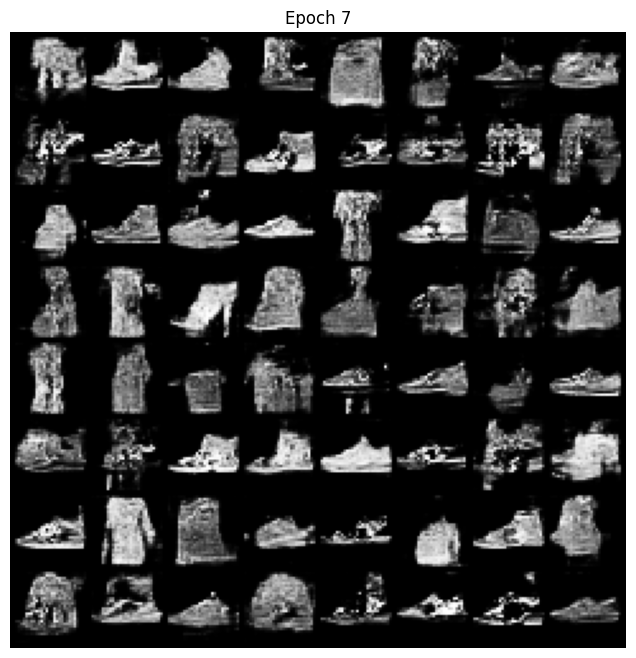

Epoch [8/50]: 100%|██████████| 938/938 [01:07<00:00, 13.88batch/s, d_loss=0.284, g_loss=4.41]


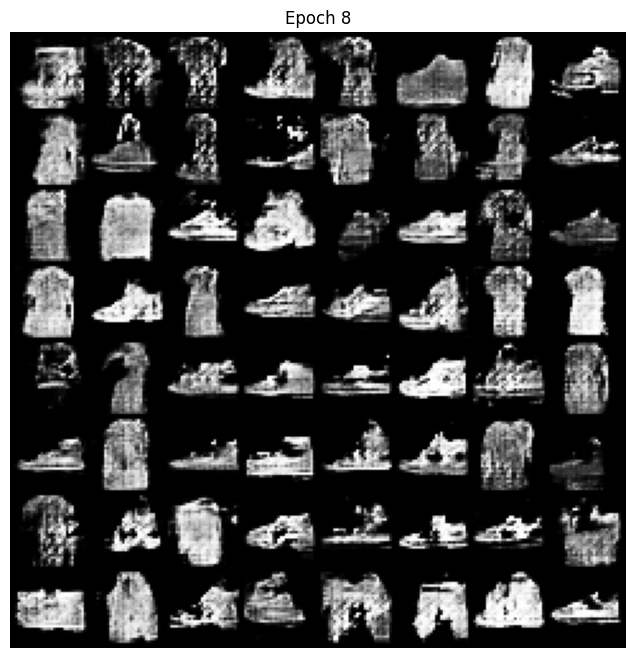

Epoch [9/50]: 100%|██████████| 938/938 [01:08<00:00, 13.65batch/s, d_loss=0.521, g_loss=2.7]


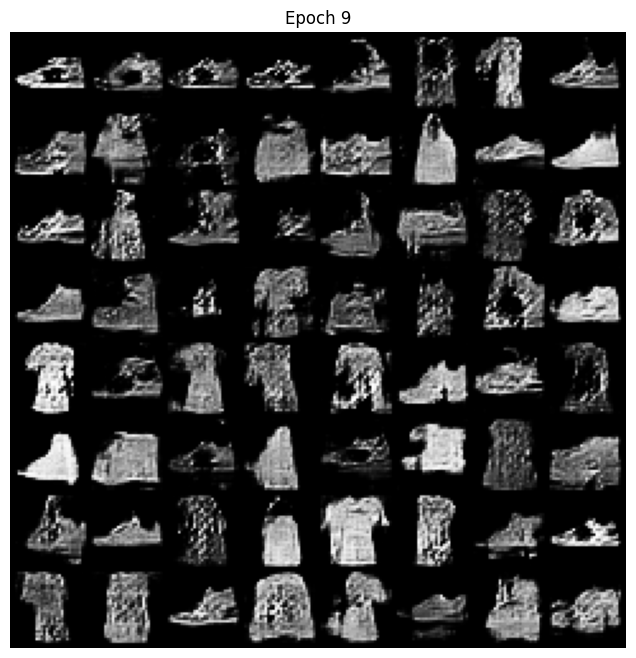

Epoch [10/50]: 100%|██████████| 938/938 [01:09<00:00, 13.49batch/s, d_loss=0.318, g_loss=2.36]


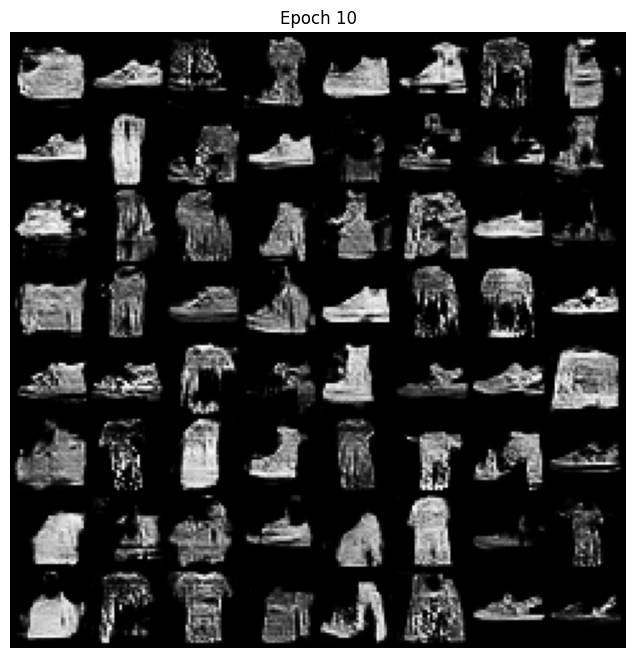

Epoch [11/50]: 100%|██████████| 938/938 [01:10<00:00, 13.35batch/s, d_loss=0.377, g_loss=3.47]


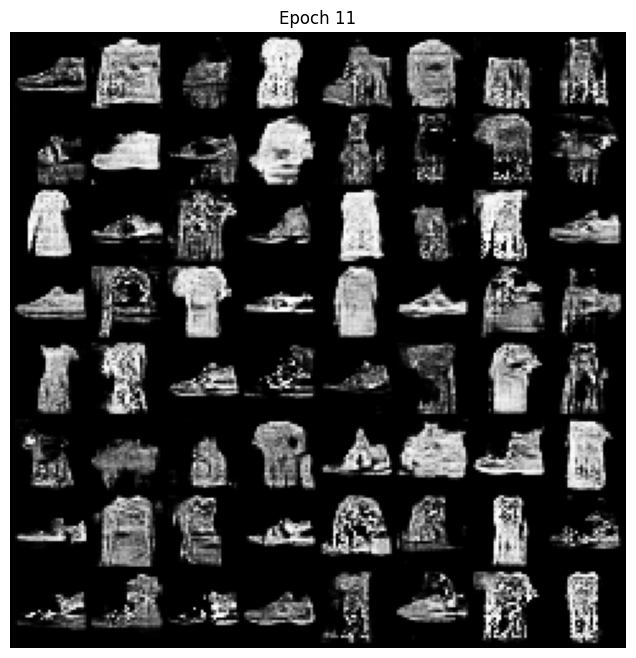

Epoch [12/50]: 100%|██████████| 938/938 [01:10<00:00, 13.27batch/s, d_loss=0.34, g_loss=3.32]


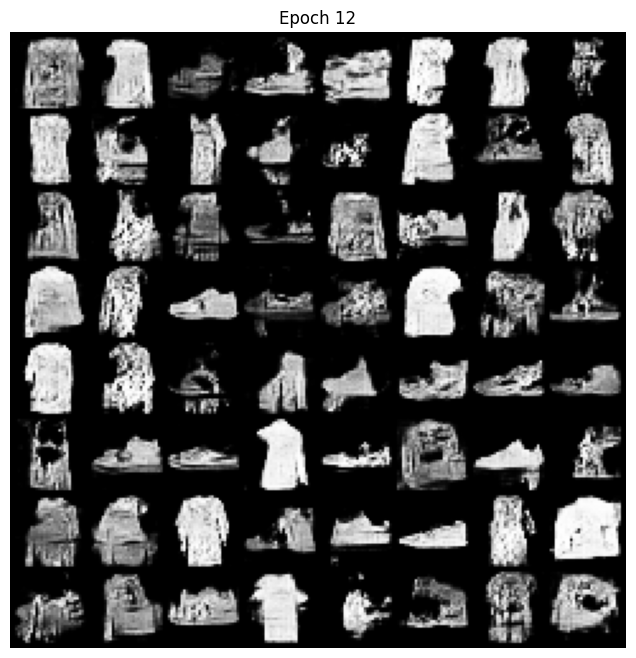

Epoch [13/50]: 100%|██████████| 938/938 [01:09<00:00, 13.51batch/s, d_loss=0.327, g_loss=2.39]


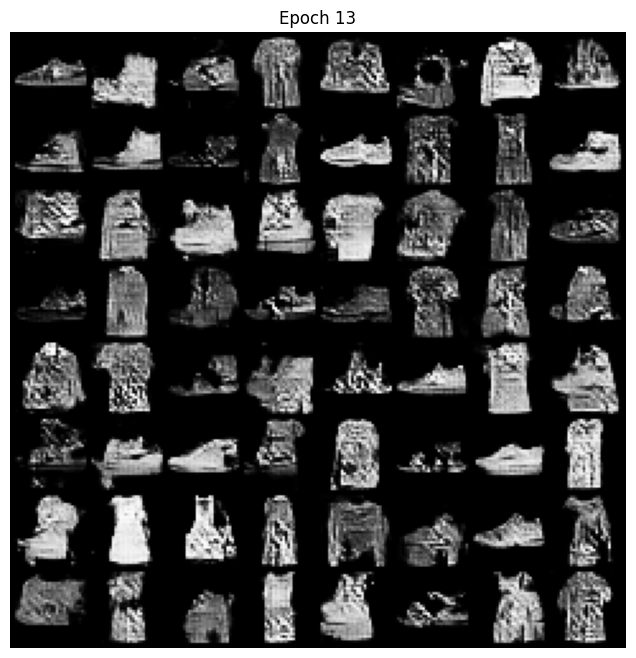

Epoch [14/50]: 100%|██████████| 938/938 [01:09<00:00, 13.54batch/s, d_loss=0.382, g_loss=3.13]


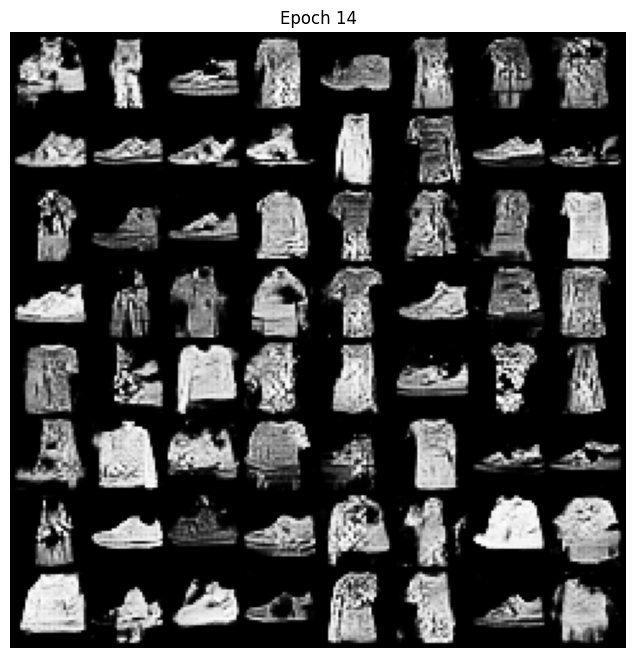

Epoch [15/50]: 100%|██████████| 938/938 [01:09<00:00, 13.57batch/s, d_loss=0.369, g_loss=2.79]


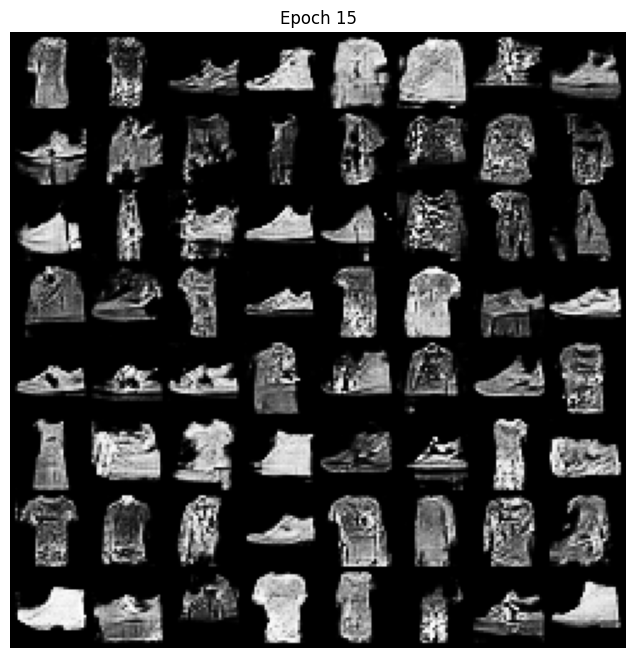

Epoch [16/50]: 100%|██████████| 938/938 [01:09<00:00, 13.51batch/s, d_loss=0.457, g_loss=2.75]


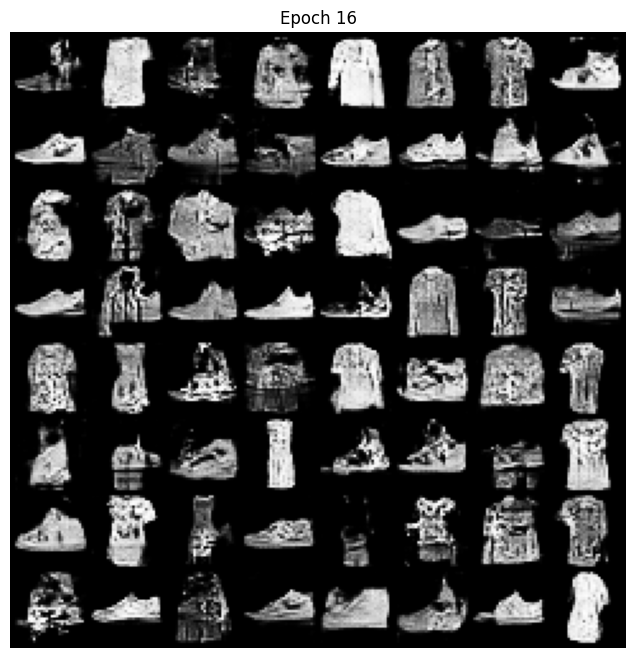

Epoch [17/50]: 100%|██████████| 938/938 [01:10<00:00, 13.35batch/s, d_loss=0.242, g_loss=2.64]


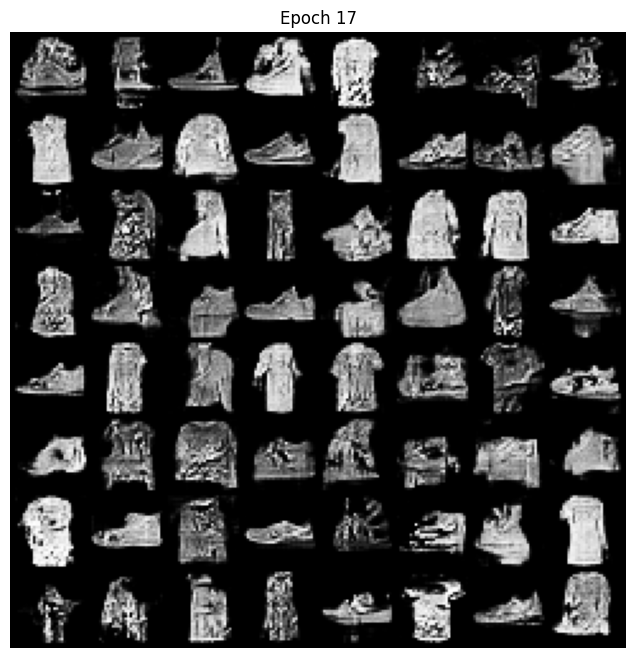

Epoch [18/50]: 100%|██████████| 938/938 [01:10<00:00, 13.36batch/s, d_loss=0.224, g_loss=3.15]


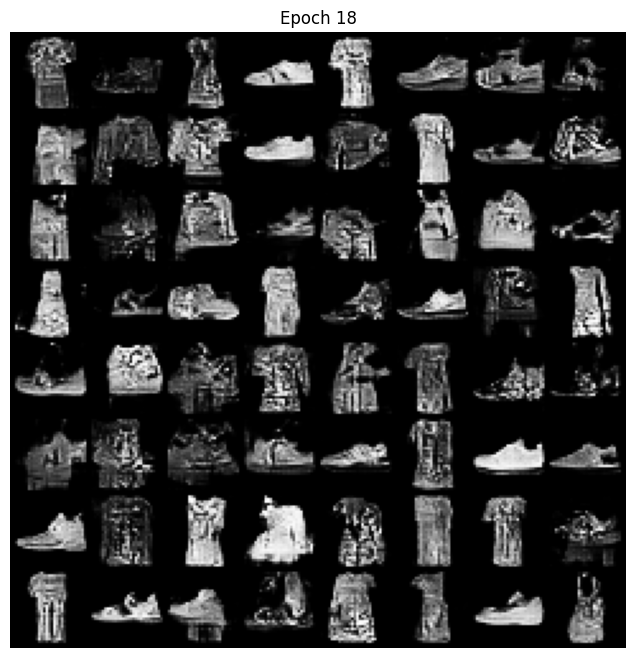

Epoch [19/50]: 100%|██████████| 938/938 [01:09<00:00, 13.49batch/s, d_loss=0.634, g_loss=3.04]


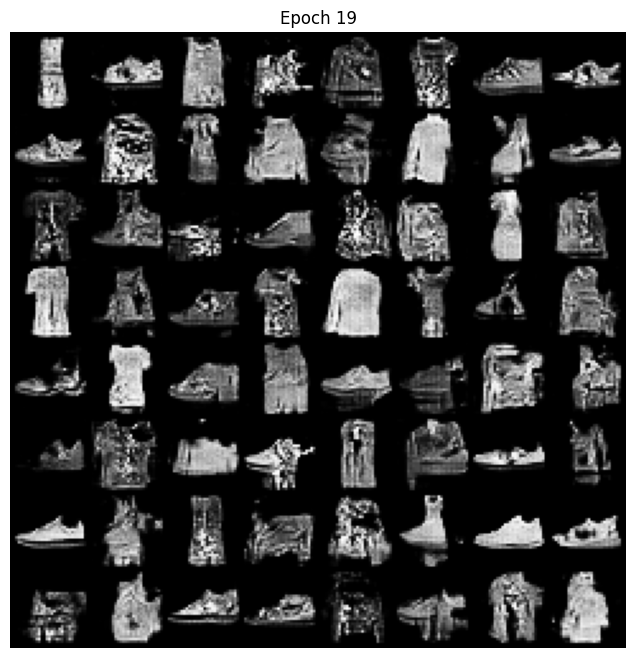

Epoch [20/50]: 100%|██████████| 938/938 [01:09<00:00, 13.47batch/s, d_loss=0.275, g_loss=3.13]


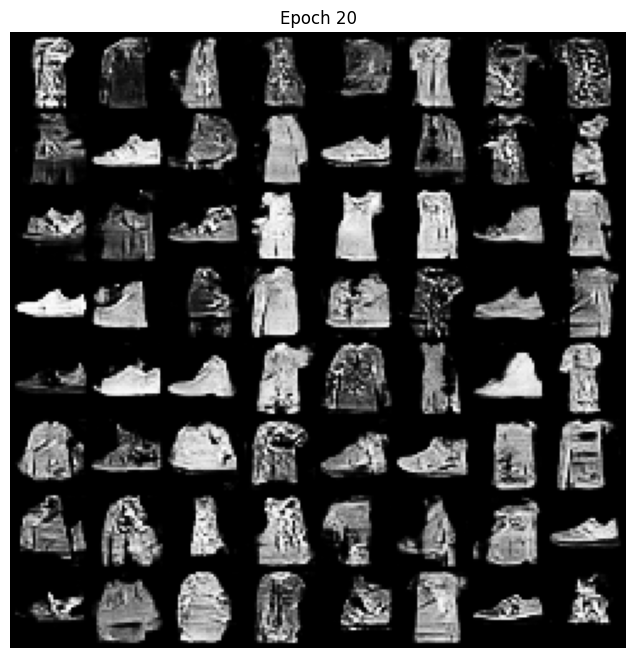

Epoch [21/50]: 100%|██████████| 938/938 [01:09<00:00, 13.45batch/s, d_loss=0.141, g_loss=3.51]


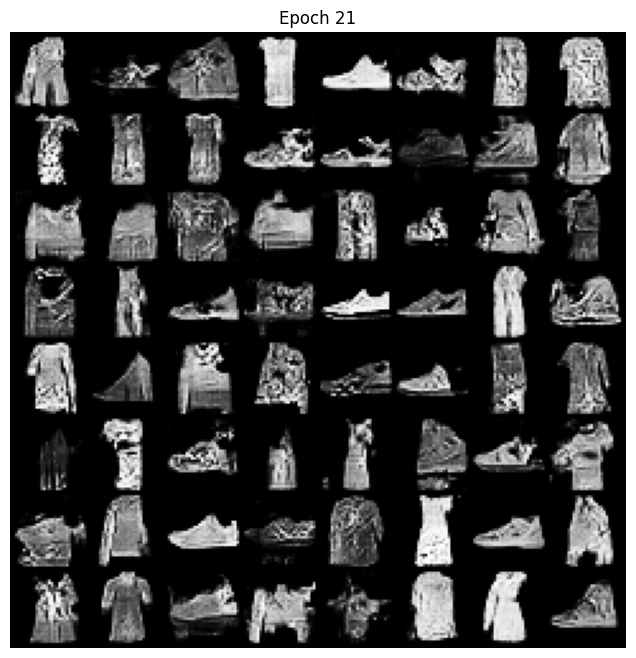

Epoch [22/50]: 100%|██████████| 938/938 [01:10<00:00, 13.33batch/s, d_loss=0.211, g_loss=3.51]


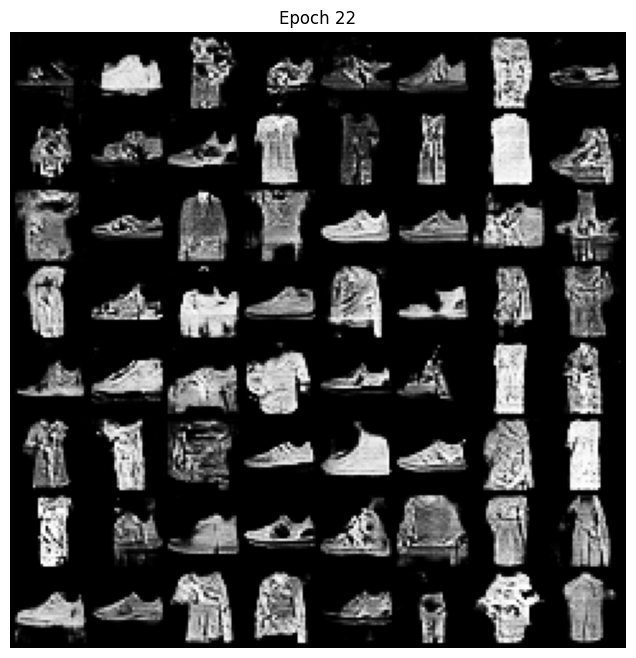

Epoch [23/50]: 100%|██████████| 938/938 [01:09<00:00, 13.47batch/s, d_loss=0.406, g_loss=3.39]


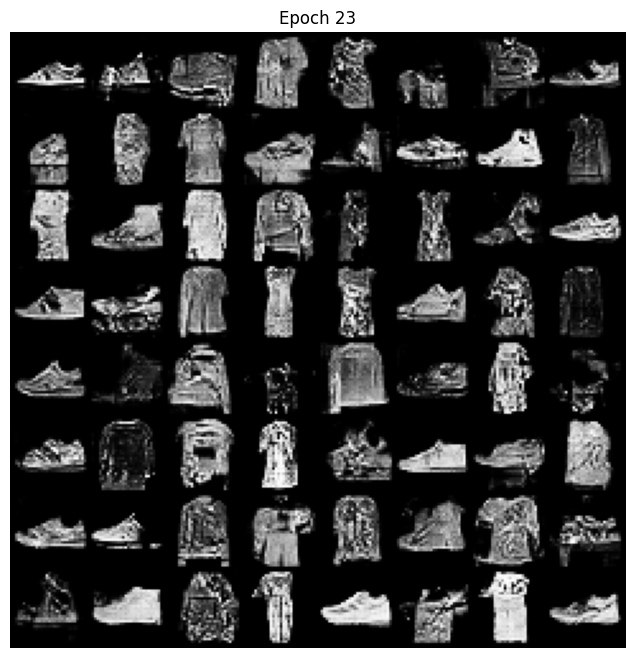

Epoch [24/50]: 100%|██████████| 938/938 [01:10<00:00, 13.24batch/s, d_loss=0.319, g_loss=3.96]


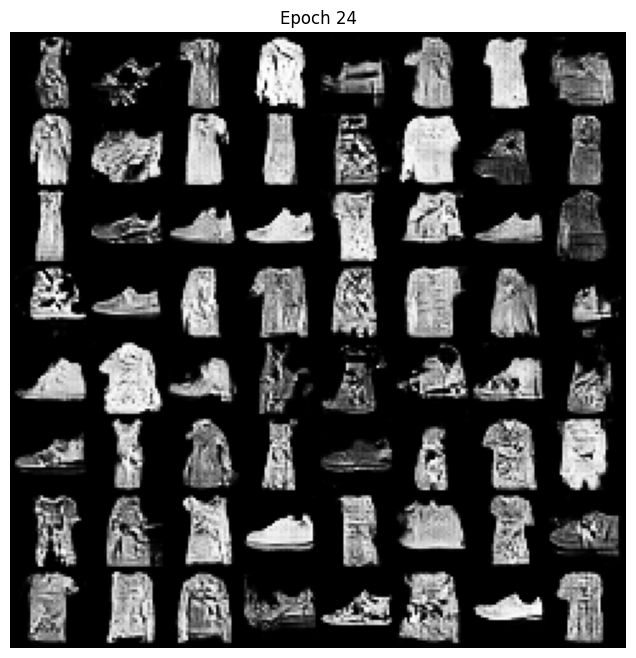

Epoch [25/50]: 100%|██████████| 938/938 [01:11<00:00, 13.06batch/s, d_loss=0.466, g_loss=3.25]


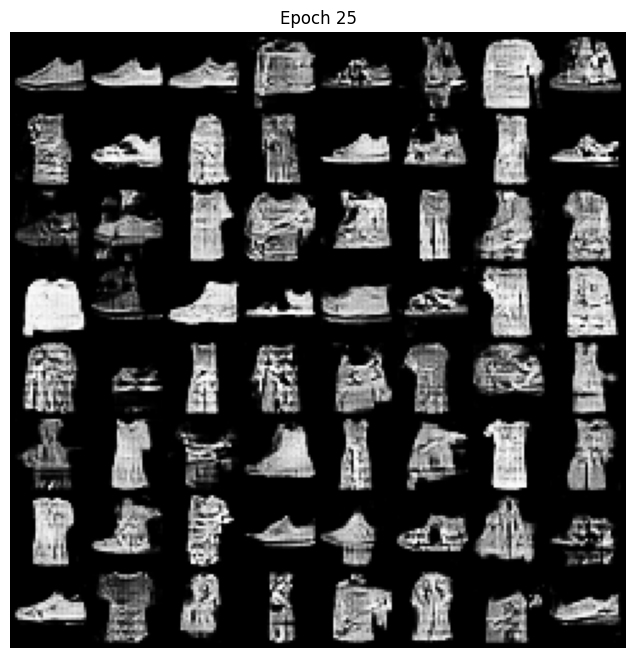

Epoch [26/50]: 100%|██████████| 938/938 [01:13<00:00, 12.85batch/s, d_loss=0.44, g_loss=3.71]


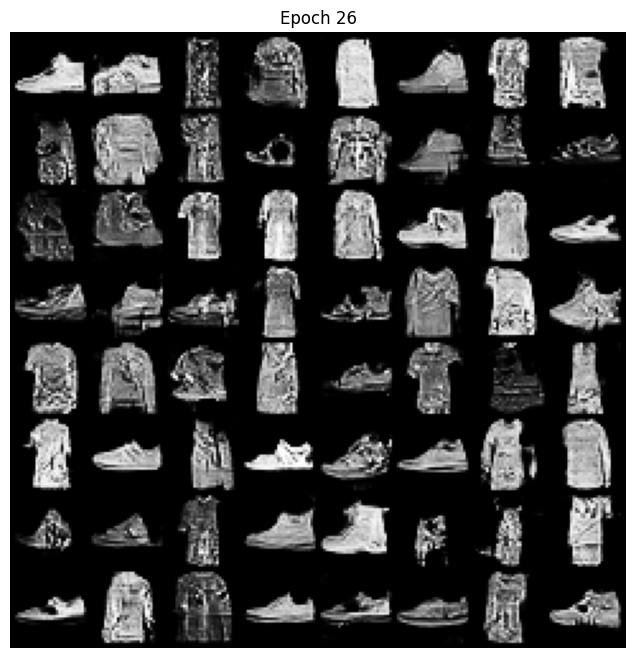

Epoch [27/50]: 100%|██████████| 938/938 [01:12<00:00, 12.97batch/s, d_loss=0.405, g_loss=3.34]


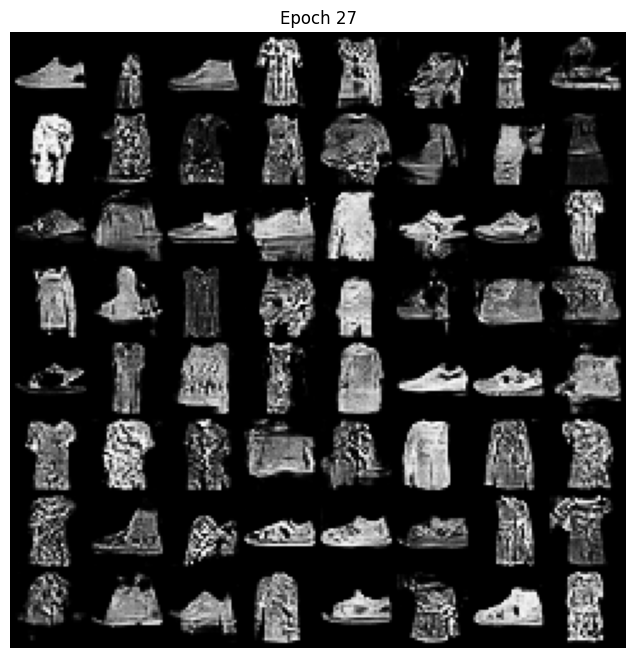

Epoch [28/50]: 100%|██████████| 938/938 [01:12<00:00, 12.88batch/s, d_loss=0.221, g_loss=3.75]


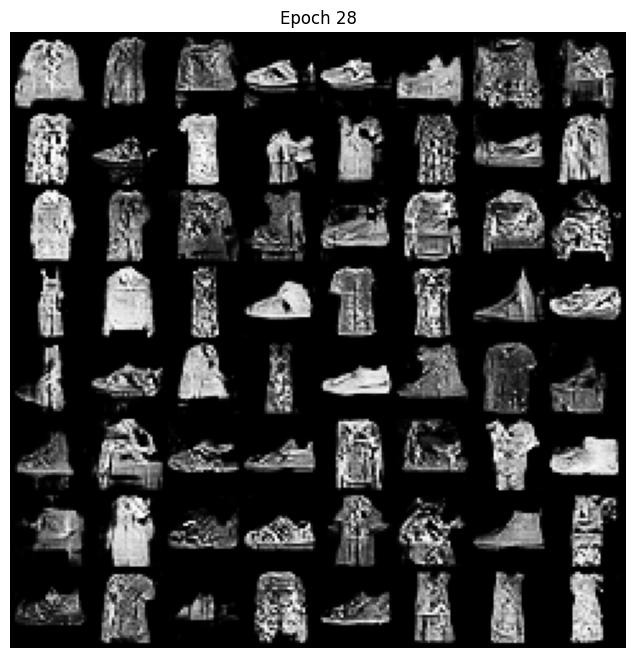

Epoch [29/50]: 100%|██████████| 938/938 [01:12<00:00, 12.93batch/s, d_loss=0.661, g_loss=4.06]


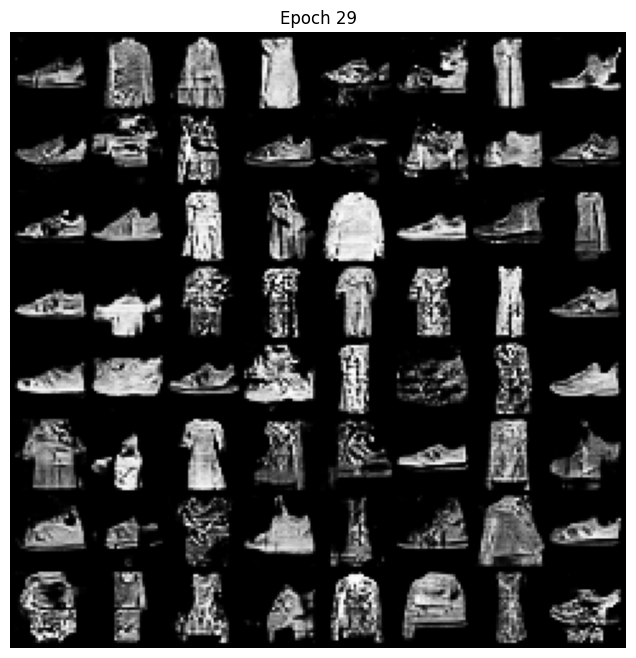

Epoch [30/50]: 100%|██████████| 938/938 [01:13<00:00, 12.76batch/s, d_loss=0.114, g_loss=4.19]


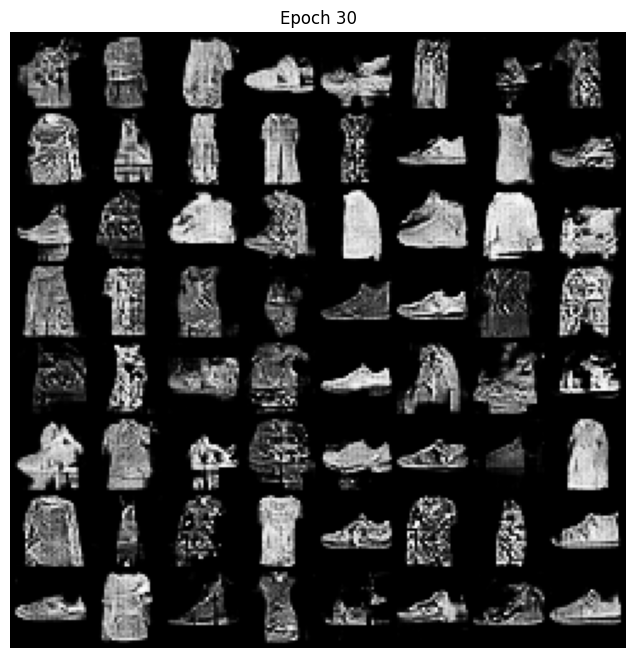

Epoch [31/50]: 100%|██████████| 938/938 [01:12<00:00, 12.88batch/s, d_loss=0.201, g_loss=3.74]


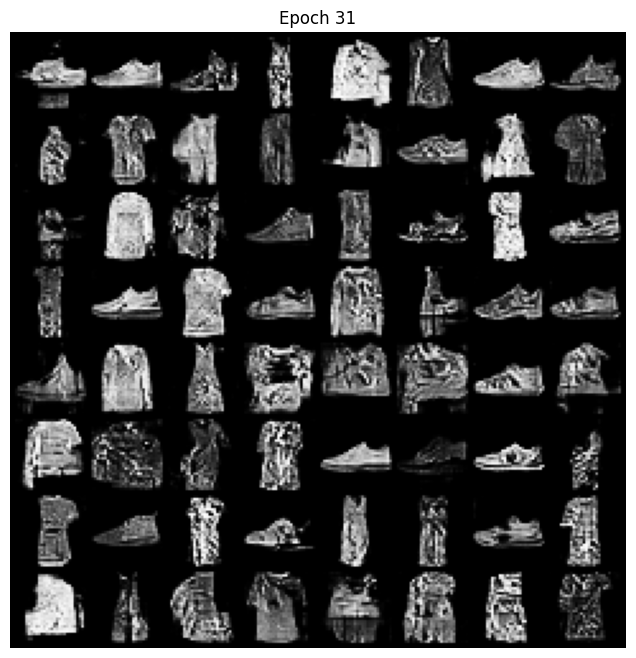

Epoch [32/50]: 100%|██████████| 938/938 [01:13<00:00, 12.83batch/s, d_loss=0.224, g_loss=3.99]


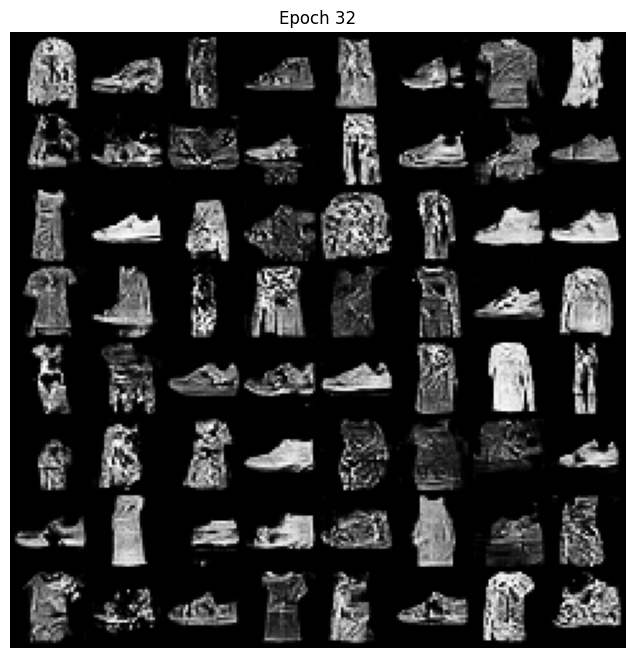

Epoch [33/50]: 100%|██████████| 938/938 [01:12<00:00, 12.87batch/s, d_loss=0.22, g_loss=3.46]


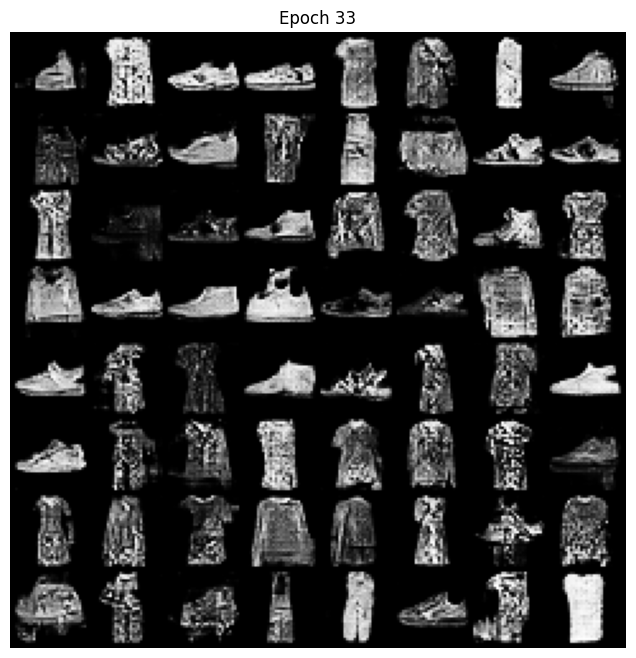

Epoch [34/50]: 100%|██████████| 938/938 [01:13<00:00, 12.83batch/s, d_loss=0.241, g_loss=4.2]


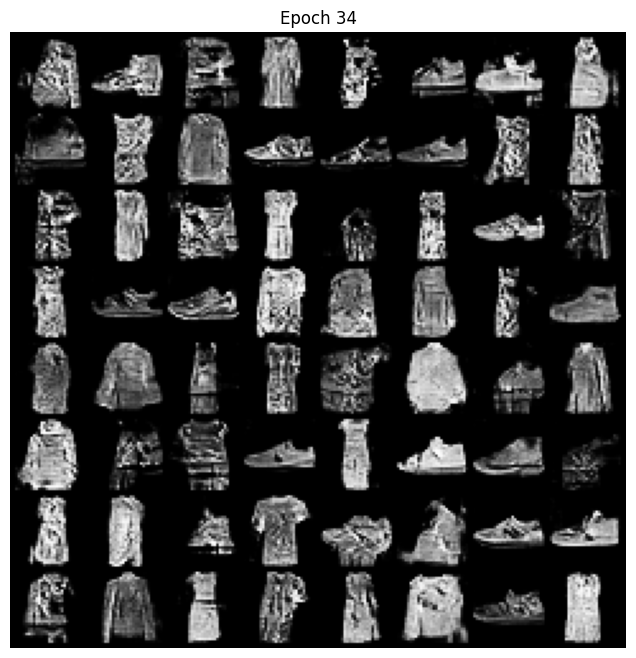

Epoch [35/50]: 100%|██████████| 938/938 [01:12<00:00, 12.90batch/s, d_loss=0.17, g_loss=4.48]


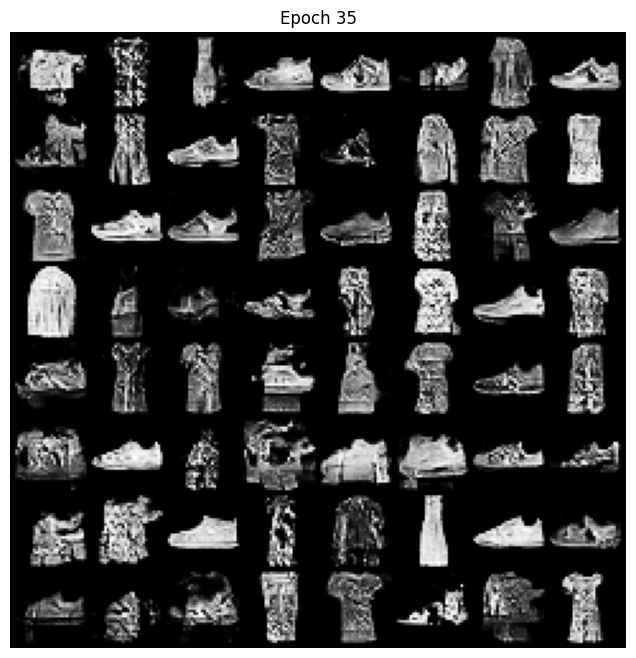

Epoch [36/50]: 100%|██████████| 938/938 [01:12<00:00, 12.87batch/s, d_loss=0.102, g_loss=3.92]


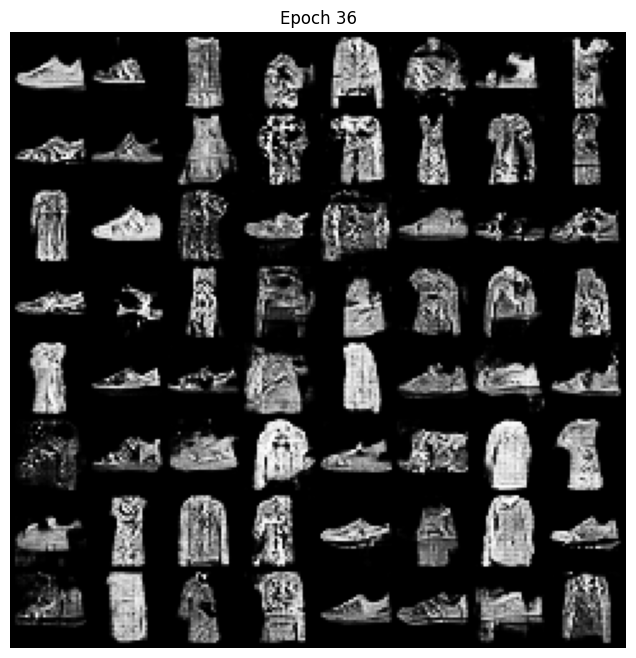

Epoch [37/50]: 100%|██████████| 938/938 [01:13<00:00, 12.83batch/s, d_loss=0.279, g_loss=4.26]


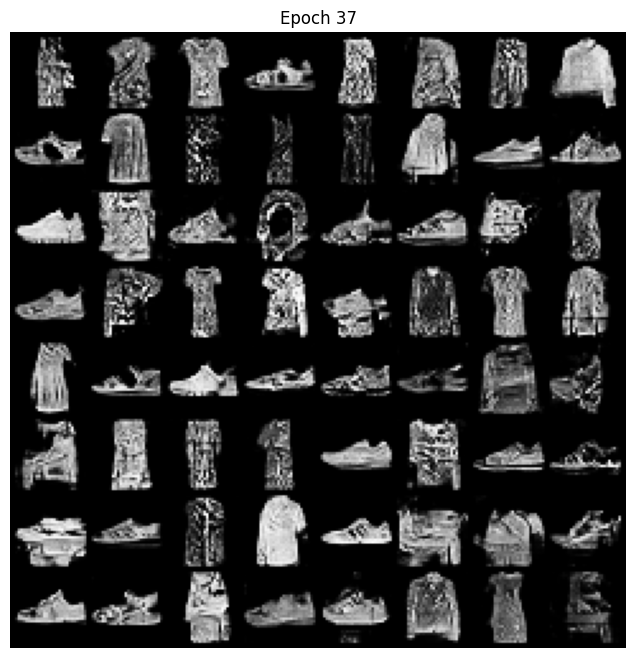

Epoch [38/50]: 100%|██████████| 938/938 [01:12<00:00, 12.87batch/s, d_loss=0.0363, g_loss=6.34]


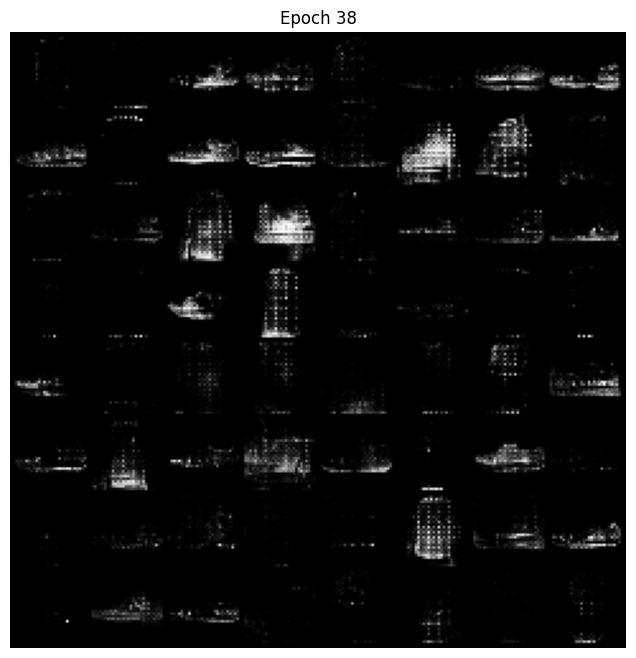

Epoch [39/50]: 100%|██████████| 938/938 [01:13<00:00, 12.79batch/s, d_loss=0.142, g_loss=4.55]


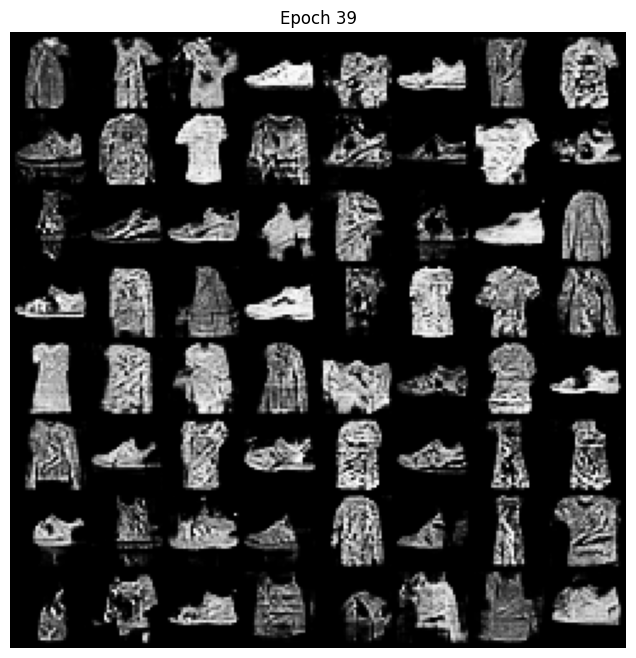

Epoch [40/50]: 100%|██████████| 938/938 [01:12<00:00, 12.86batch/s, d_loss=0.19, g_loss=5.31]


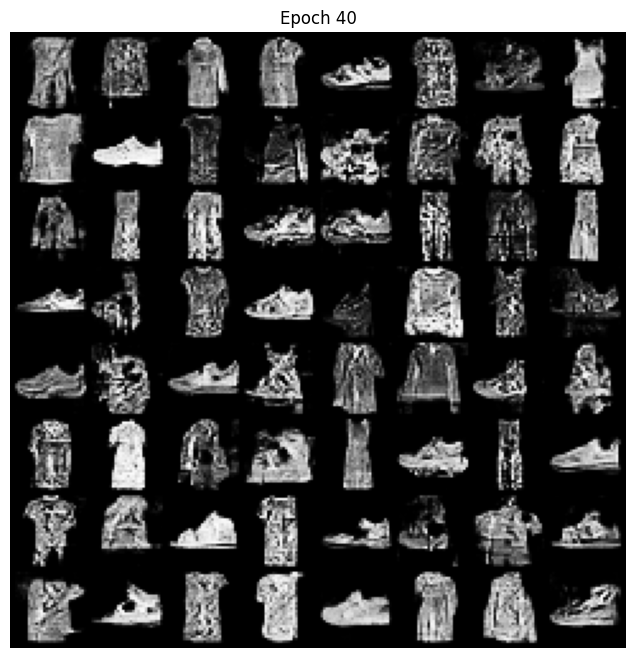

Epoch [41/50]: 100%|██████████| 938/938 [01:13<00:00, 12.75batch/s, d_loss=0.195, g_loss=4.62]


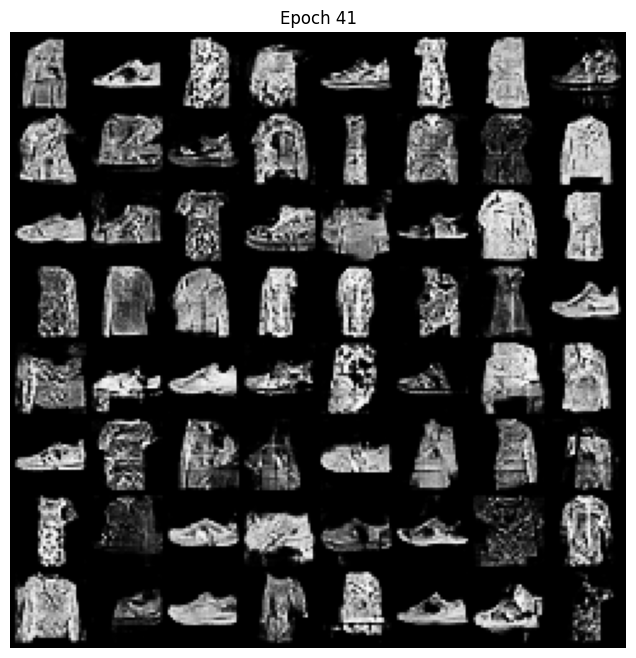

Epoch [42/50]: 100%|██████████| 938/938 [01:13<00:00, 12.85batch/s, d_loss=0.139, g_loss=4.44]


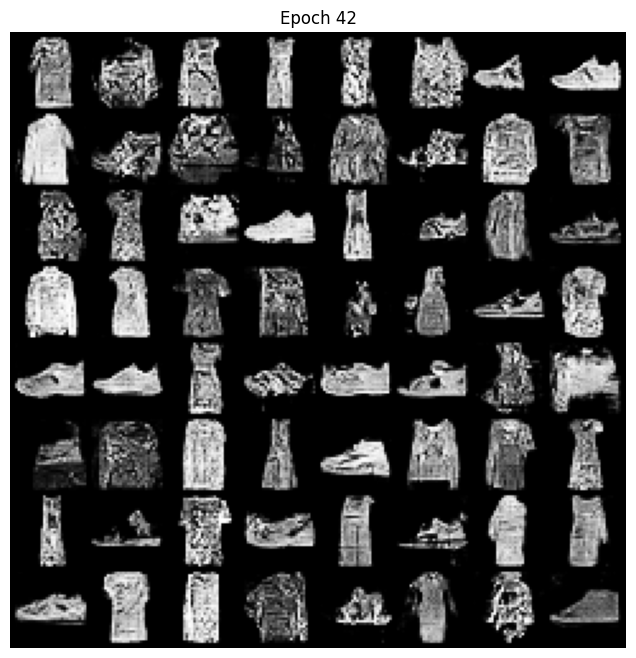

Epoch [43/50]: 100%|██████████| 938/938 [01:13<00:00, 12.68batch/s, d_loss=0.233, g_loss=5.12]


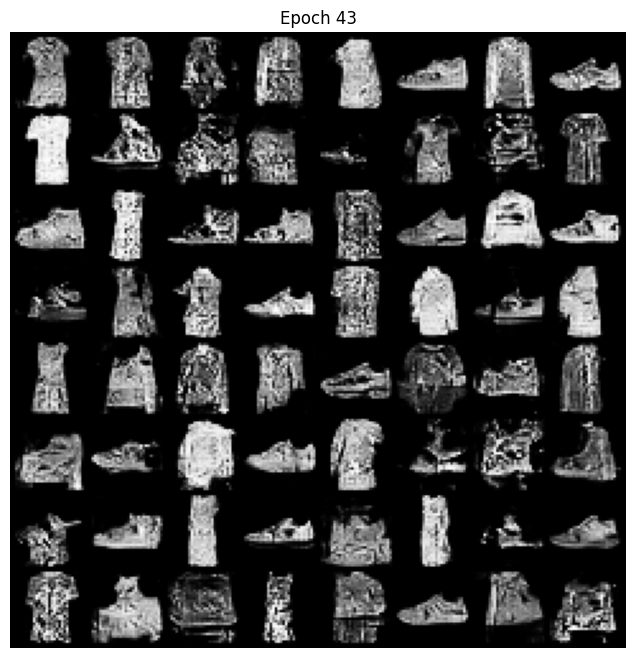

Epoch [44/50]: 100%|██████████| 938/938 [01:12<00:00, 12.89batch/s, d_loss=0.121, g_loss=5.32]


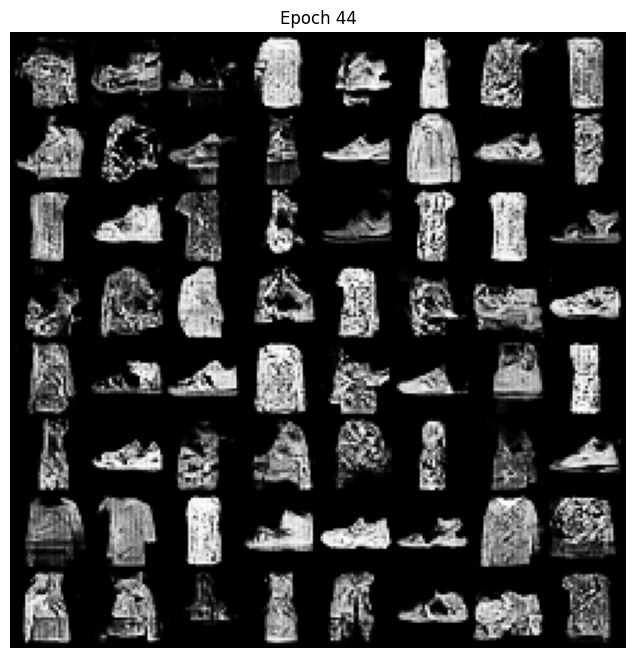

Epoch [45/50]: 100%|██████████| 938/938 [01:13<00:00, 12.69batch/s, d_loss=0.234, g_loss=4.98]


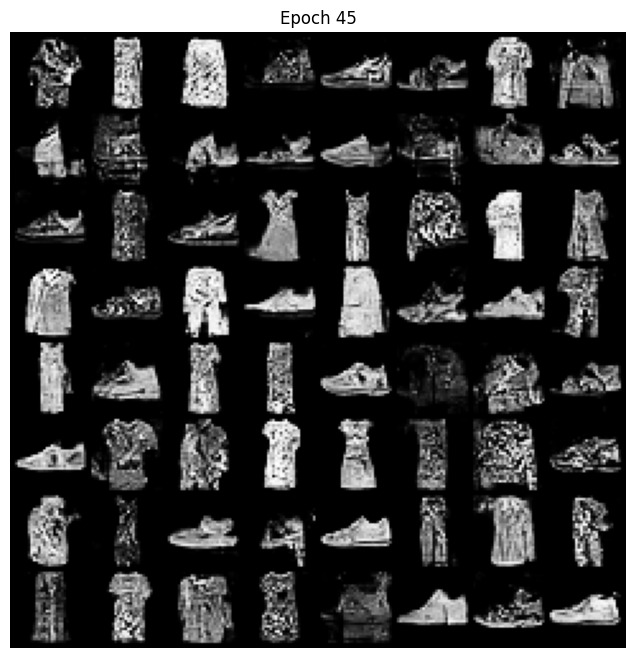

Epoch [46/50]: 100%|██████████| 938/938 [01:14<00:00, 12.67batch/s, d_loss=0.121, g_loss=5.38]


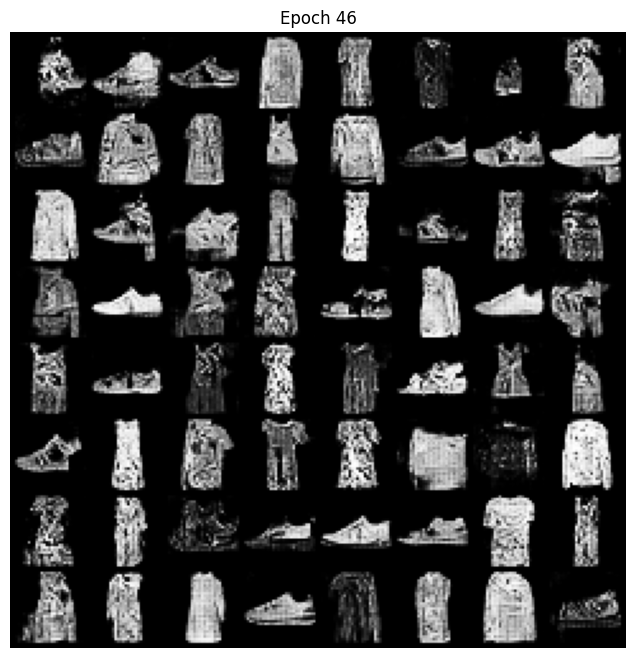

Epoch [47/50]: 100%|██████████| 938/938 [01:13<00:00, 12.78batch/s, d_loss=0.145, g_loss=4.79]


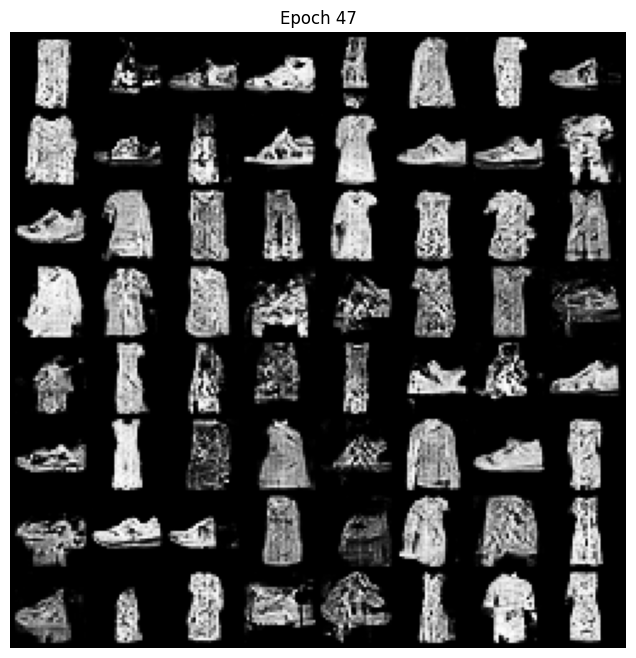

Epoch [48/50]: 100%|██████████| 938/938 [01:12<00:00, 12.93batch/s, d_loss=0.145, g_loss=5.1]


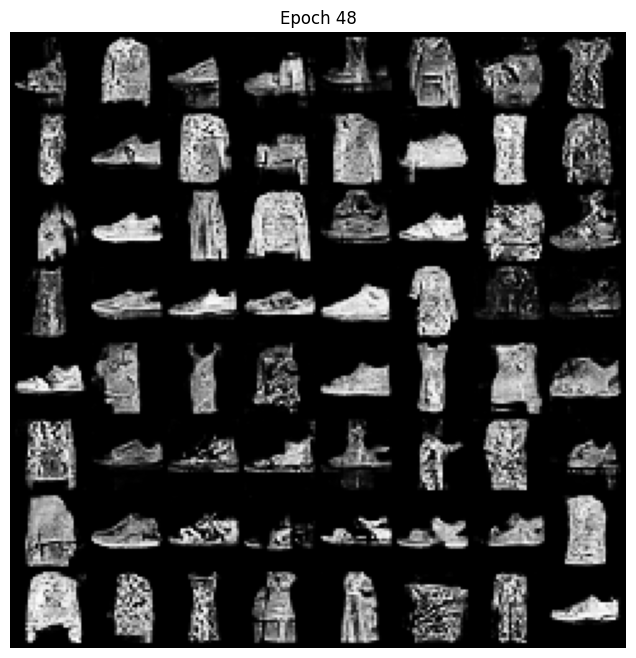

Epoch [49/50]: 100%|██████████| 938/938 [01:12<00:00, 12.95batch/s, d_loss=0.308, g_loss=5.35]


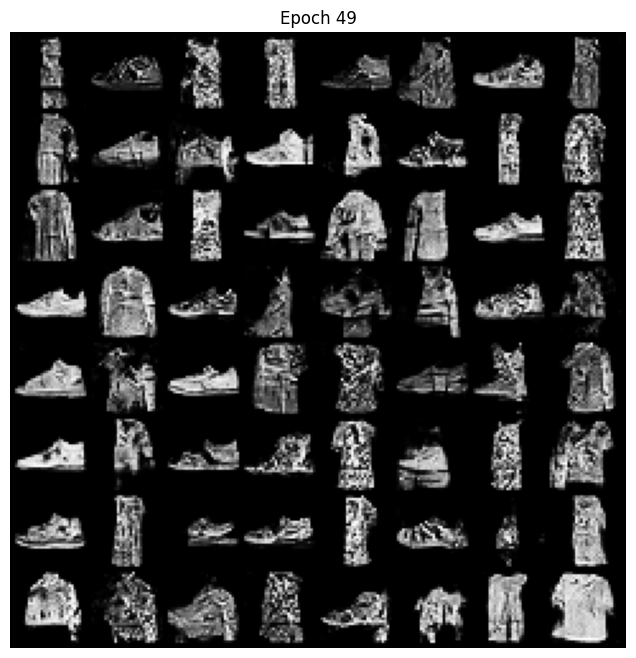

Epoch [50/50]: 100%|██████████| 938/938 [01:12<00:00, 13.02batch/s, d_loss=0.126, g_loss=6.11]


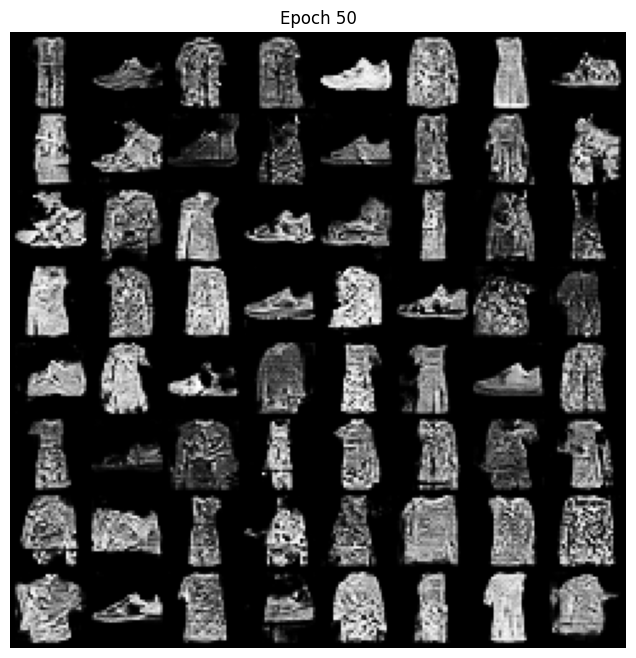

In [11]:
lrG = 1e-3  # Generator's learning rate
lrD = 1e-3  # Lower Discriminator's learning rate

# Initialize the models
netG = Architecture_1_Generator()
netD = Architecture_1_Discriminator()

# Loss function and optimizers
criterion = nn.BCELoss()  # Binary Cross Entropy Loss for real/fake classification
optimizerD = optim.Adam(netD.parameters(), lr=lrD, betas=(0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lrG, betas=(0.5, 0.999))

# Hyperparameters
batch_size = 64
num_epochs = 50
n_critic = 1  # Number of discriminator updates per generator update

# Loss and optimizers
criterion = nn.BCELoss()
optimizer_G = optim.Adam(netG.parameters(), lr=lrG)
optimizer_D = optim.Adam(netD.parameters(), lr=lrD)

G_losses = []
D_losses = []

# Training
for epoch in range(num_epochs):
    with tqdm(total=len(data_loader), desc=f'Epoch [{epoch+1}/{num_epochs}]', unit='batch') as pbar:
        for imgs, _ in data_loader:
            batch_size = imgs.size(0)

            # Labels
            real_labels = torch.ones(batch_size, 1)
            fake_labels = torch.zeros(batch_size, 1)

            # Train Discriminator n_critic times
            for _ in range(n_critic):
                optimizer_D.zero_grad()
                outputs = netD(imgs)
                d_loss_real = criterion(outputs, real_labels)
                d_loss_real.backward()

                z = torch.randn(batch_size, 100)
                fake_imgs = netG(z)
                outputs = netD(fake_imgs.detach())
                d_loss_fake = criterion(outputs, fake_labels)
                d_loss_fake.backward()
                optimizer_D.step()

            d_loss = d_loss_real + d_loss_fake
            D_losses.append(d_loss.item())

            # Train Generator
            optimizer_G.zero_grad()
            outputs = netD(fake_imgs)
            g_loss = criterion(outputs, real_labels)
            g_loss.backward()
            optimizer_G.step()

            G_losses.append(g_loss.item())

            # Update progress bar
            pbar.update(1)
            pbar.set_postfix(d_loss=d_loss_real.item() + d_loss_fake.item(), g_loss=g_loss.item())

    # Generate and visualize images at the end of each epoch
    z = torch.randn(64, 100)
    generated_imgs = netG(z).detach().cpu()
    grid_img = torchvision.utils.make_grid(generated_imgs, nrow=8, normalize=True)

    plt.figure(figsize=(8, 8))
    plt.imshow(grid_img.permute(1, 2, 0).numpy(), cmap='gray')
    plt.axis('off')
    plt.title(f'Epoch {epoch+1}')
    plt.show()


    torch.save(netG.state_dict(), os.path.join(output_dir, 'DCGAN_generator_last.pth'))
    torch.save(netD.state_dict(), os.path.join(output_dir, 'DCGAN_discriminator_last.pth'))

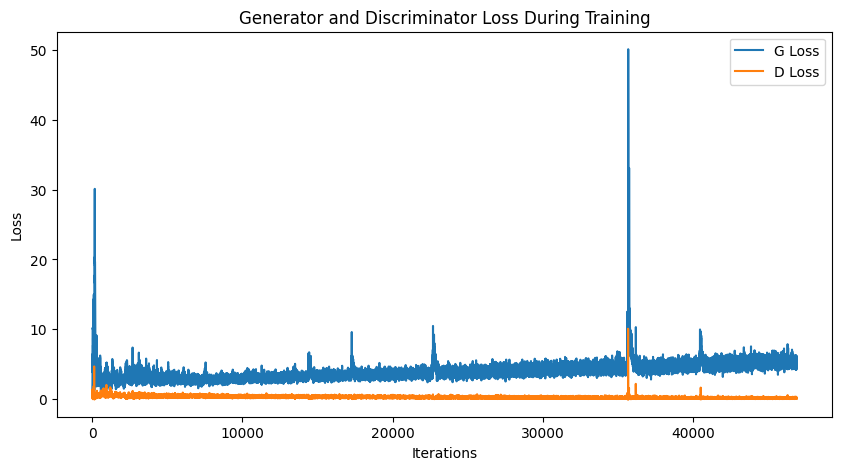

In [12]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses, label="G Loss")
plt.plot(D_losses, label="D Loss")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

# WGAN

Epoch [1/50]: 100%|██████████| 938/938 [00:30<00:00, 30.47it/s]


Epoch [1/50] completed. D Loss: -0.08334177732467651, G Loss: -0.6302252411842346


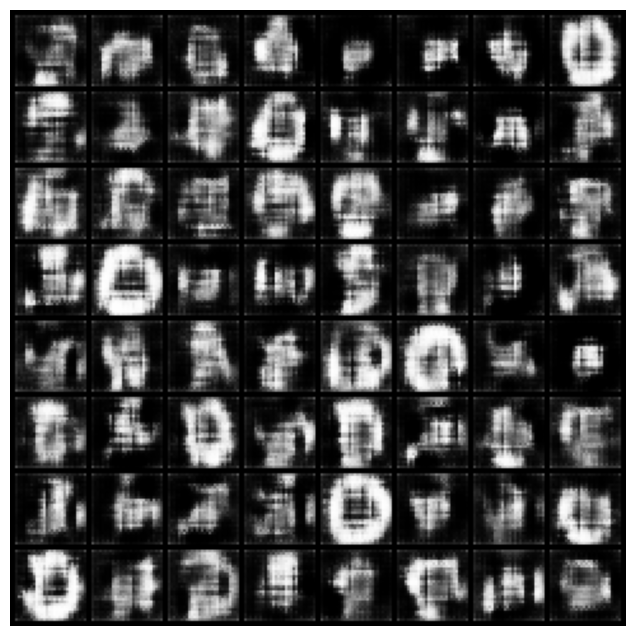

Epoch [2/50]: 100%|██████████| 938/938 [00:29<00:00, 32.25it/s]


Epoch [2/50] completed. D Loss: -0.03677612543106079, G Loss: -0.4811253249645233


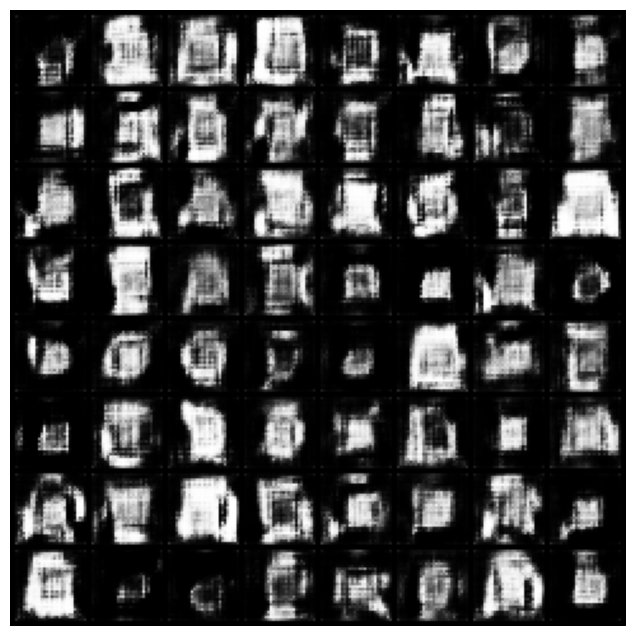

Epoch [3/50]: 100%|██████████| 938/938 [00:29<00:00, 32.18it/s]


Epoch [3/50] completed. D Loss: -0.0410008430480957, G Loss: -0.45912832021713257


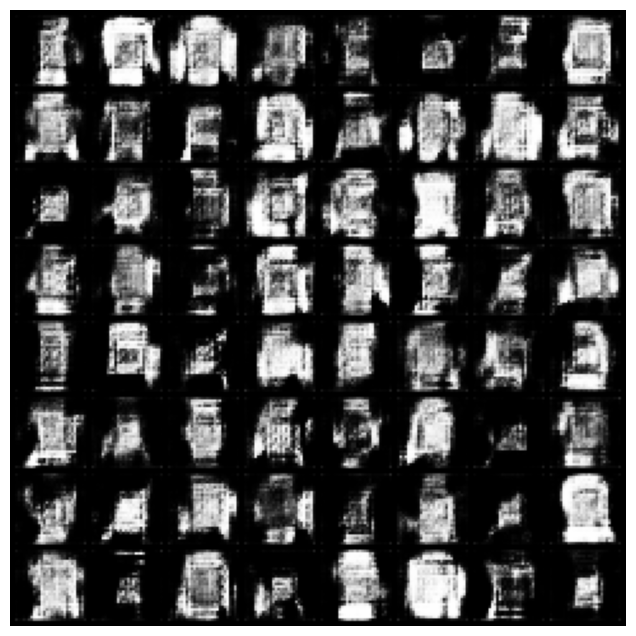

Epoch [4/50]: 100%|██████████| 938/938 [00:29<00:00, 32.17it/s]


Epoch [4/50] completed. D Loss: -0.029260367155075073, G Loss: -0.47340476512908936


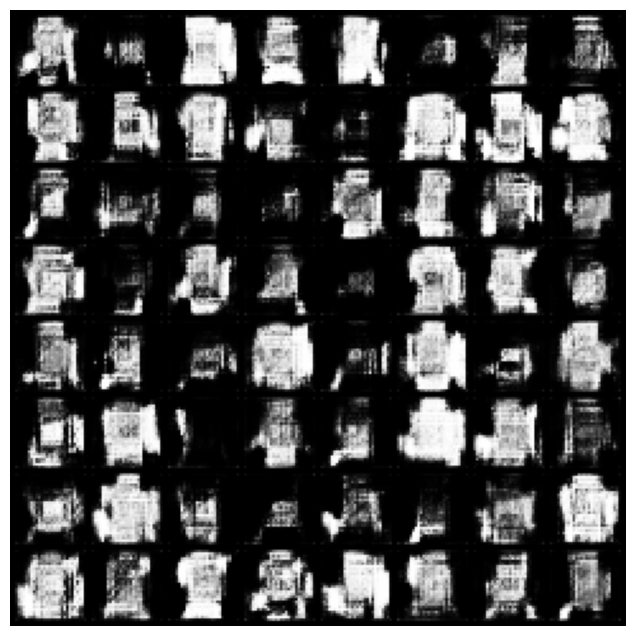

Epoch [5/50]: 100%|██████████| 938/938 [00:29<00:00, 32.11it/s]


Epoch [5/50] completed. D Loss: -0.03738471865653992, G Loss: -0.4322287440299988


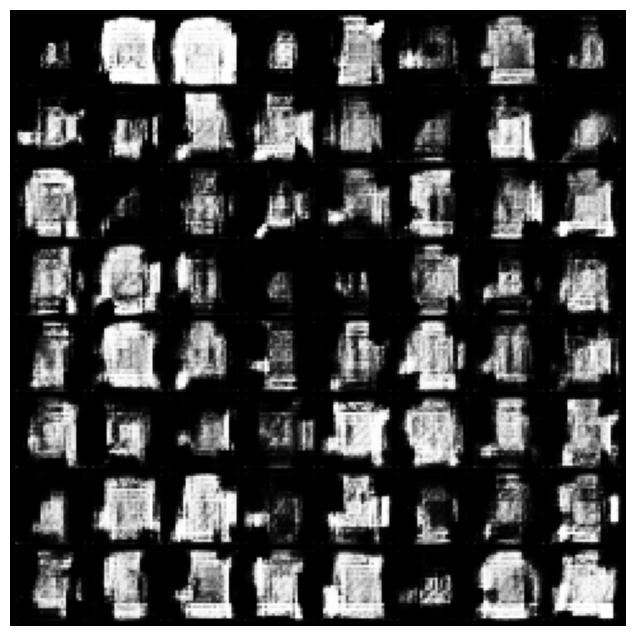

Epoch [6/50]: 100%|██████████| 938/938 [00:29<00:00, 32.11it/s]


Epoch [6/50] completed. D Loss: -0.03238007426261902, G Loss: -0.4705711007118225


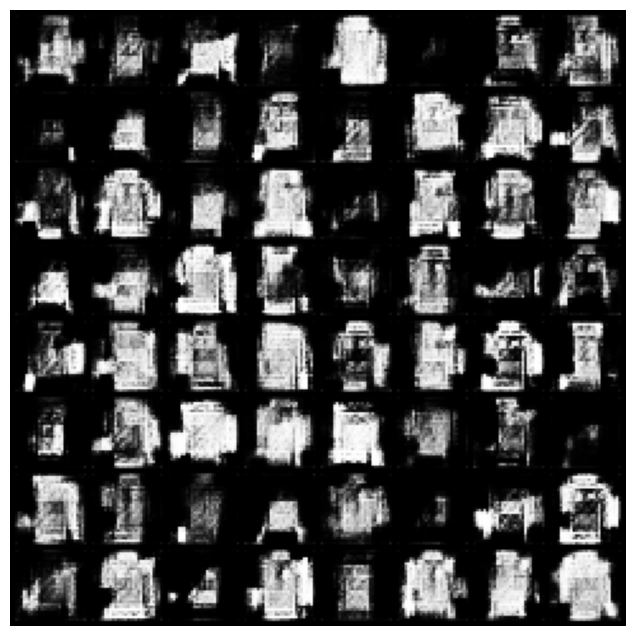

Epoch [7/50]: 100%|██████████| 938/938 [00:29<00:00, 32.22it/s]


Epoch [7/50] completed. D Loss: -0.025204479694366455, G Loss: -0.41516196727752686


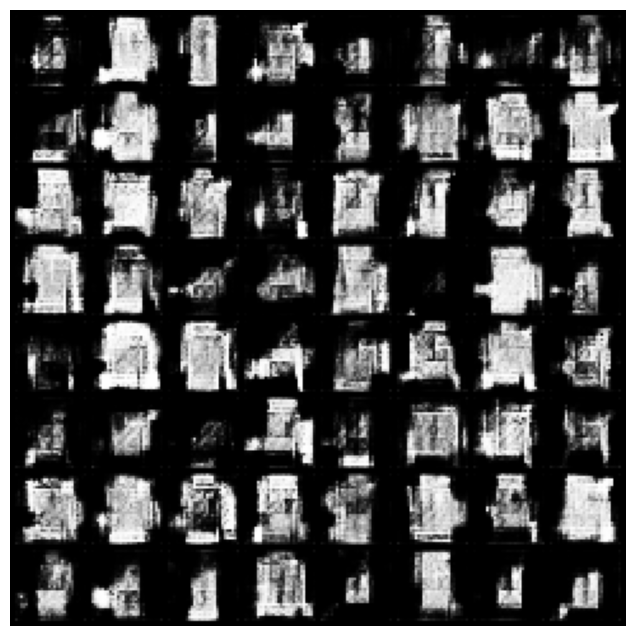

Epoch [8/50]: 100%|██████████| 938/938 [00:28<00:00, 32.38it/s]


Epoch [8/50] completed. D Loss: -0.03373834490776062, G Loss: -0.4323023855686188


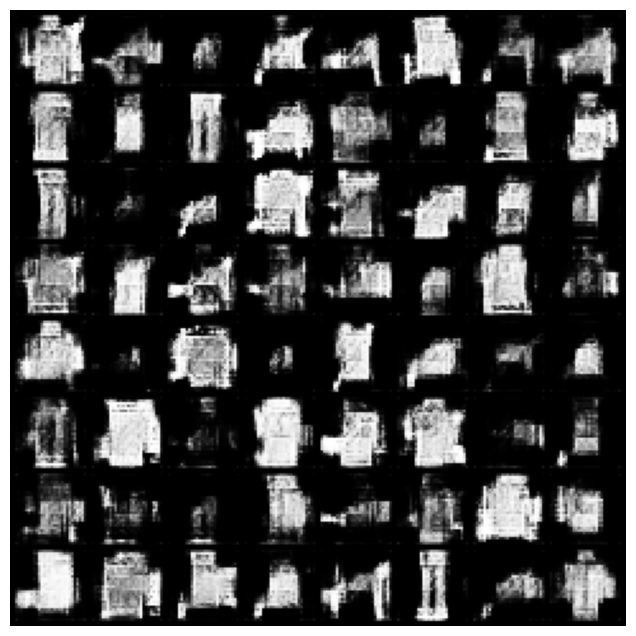

Epoch [9/50]: 100%|██████████| 938/938 [00:28<00:00, 32.39it/s]


Epoch [9/50] completed. D Loss: -0.023295164108276367, G Loss: -0.44181567430496216


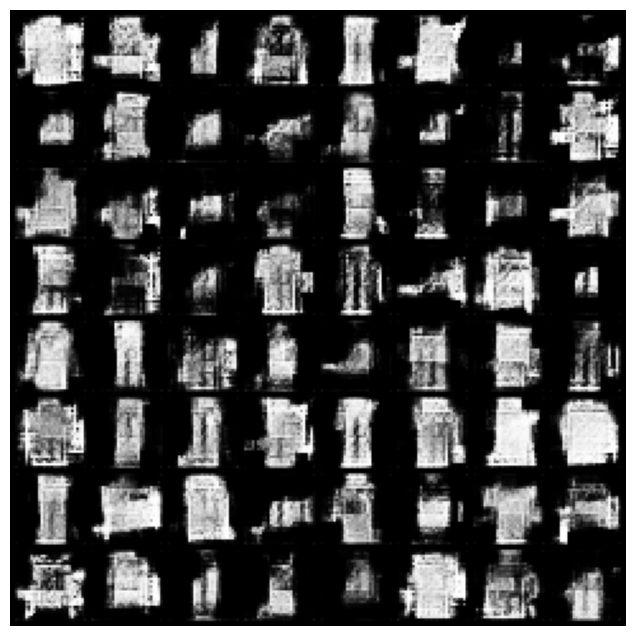

Epoch [10/50]: 100%|██████████| 938/938 [00:29<00:00, 32.01it/s]


Epoch [10/50] completed. D Loss: -0.025286823511123657, G Loss: -0.4600704312324524


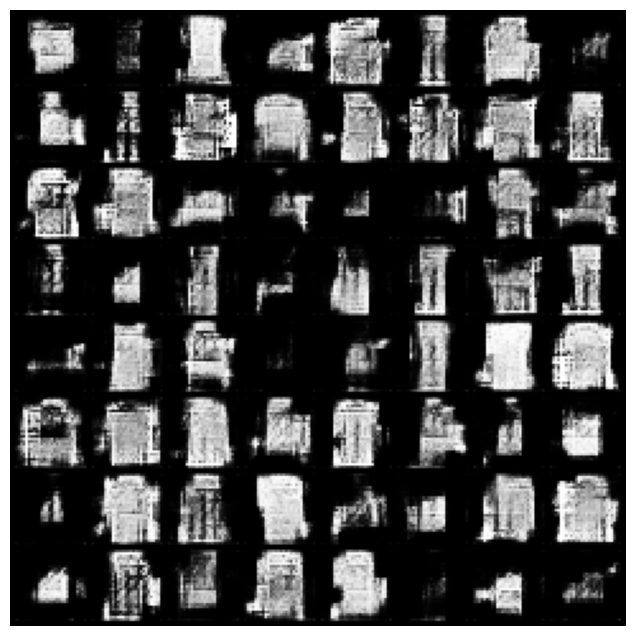

Epoch [11/50]: 100%|██████████| 938/938 [00:30<00:00, 31.12it/s]


Epoch [11/50] completed. D Loss: -0.009243190288543701, G Loss: -0.4697594940662384


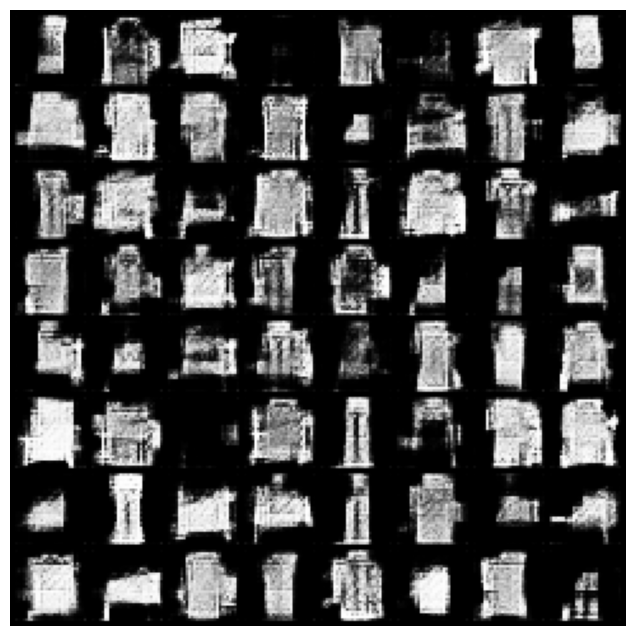

Epoch [12/50]: 100%|██████████| 938/938 [00:30<00:00, 30.90it/s]


Epoch [12/50] completed. D Loss: -0.01726597547531128, G Loss: -0.4628877341747284


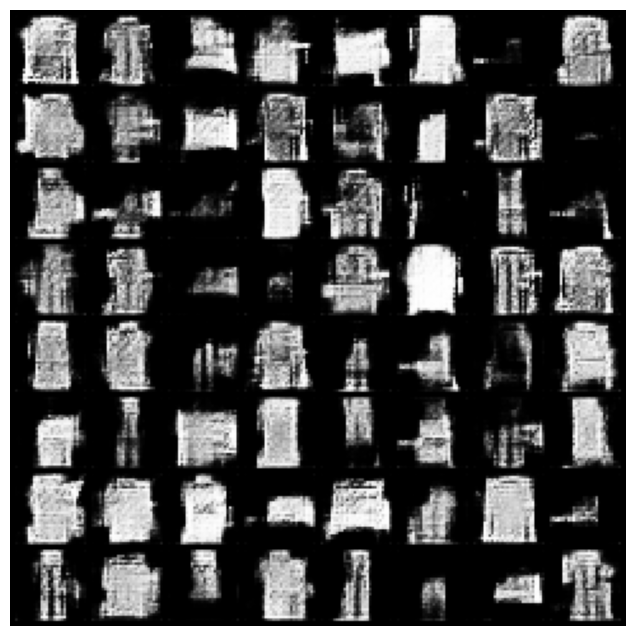

Epoch [13/50]: 100%|██████████| 938/938 [00:31<00:00, 30.26it/s]


Epoch [13/50] completed. D Loss: -0.023289740085601807, G Loss: -0.5384827256202698


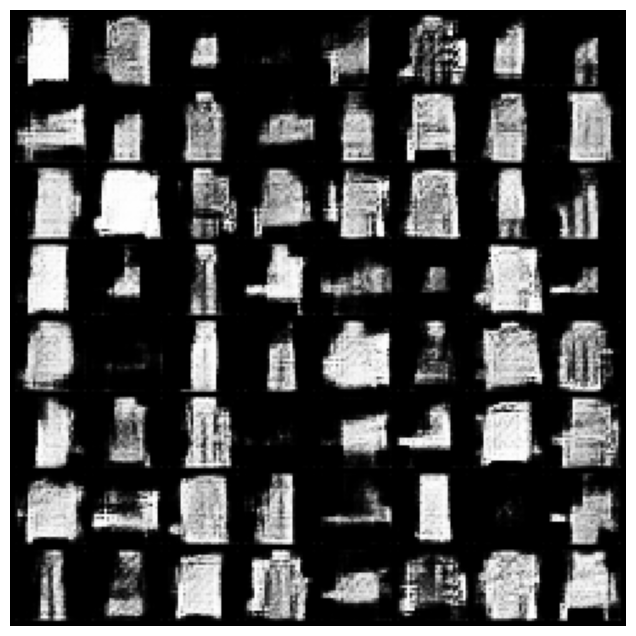

Epoch [14/50]: 100%|██████████| 938/938 [00:30<00:00, 30.52it/s]


Epoch [14/50] completed. D Loss: -0.021060079336166382, G Loss: -0.48349952697753906


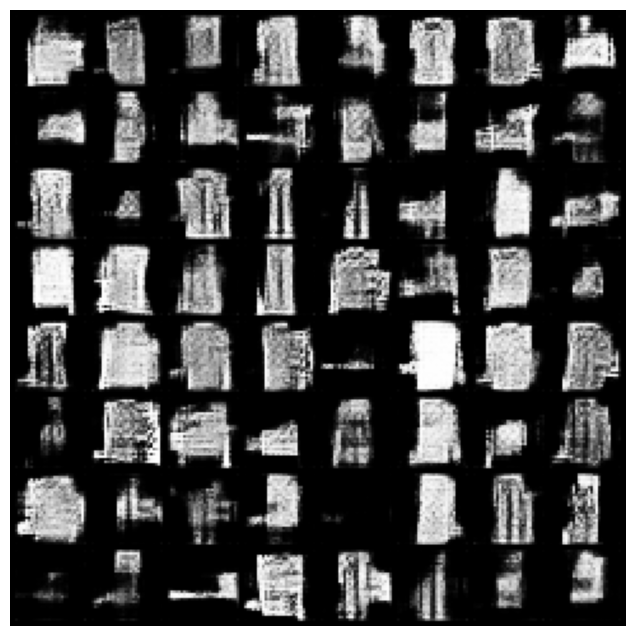

Epoch [15/50]: 100%|██████████| 938/938 [00:30<00:00, 30.89it/s]


Epoch [15/50] completed. D Loss: -0.01316159963607788, G Loss: -0.49017333984375


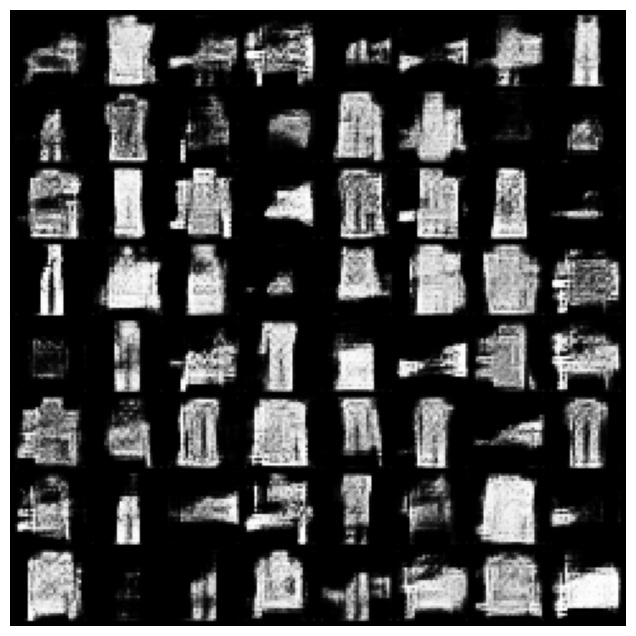

Epoch [16/50]: 100%|██████████| 938/938 [00:30<00:00, 30.73it/s]


Epoch [16/50] completed. D Loss: -0.01636400818824768, G Loss: -0.4313894212245941


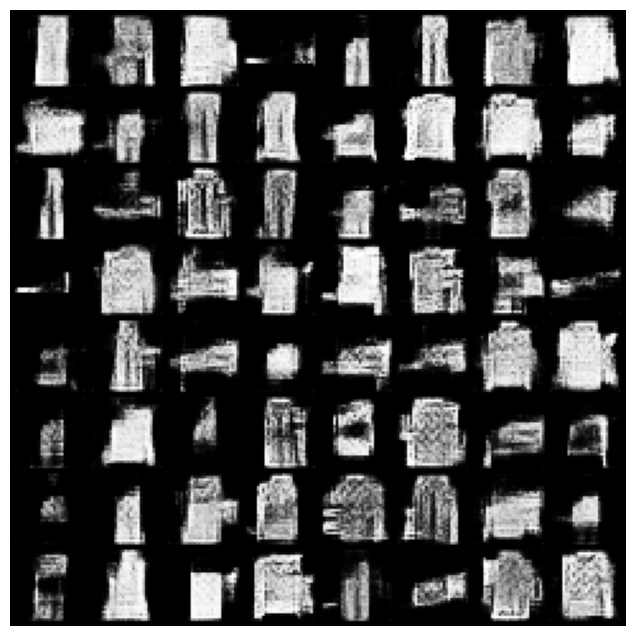

Epoch [17/50]: 100%|██████████| 938/938 [00:30<00:00, 30.29it/s]


Epoch [17/50] completed. D Loss: -0.00725102424621582, G Loss: -0.5220590233802795


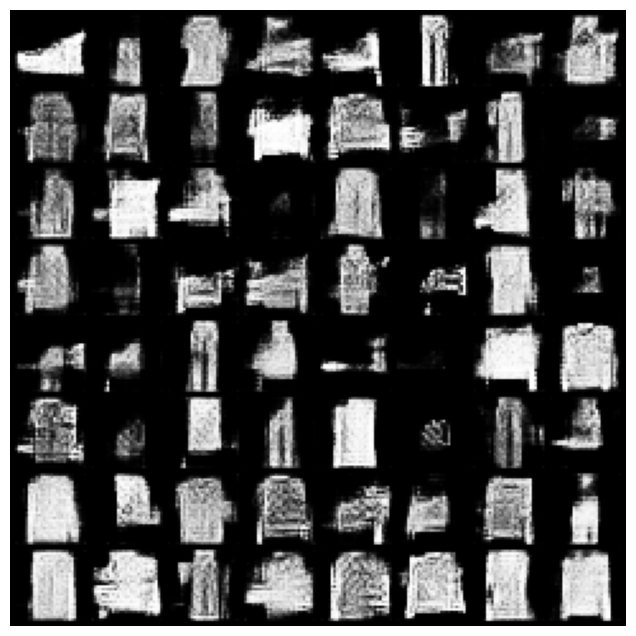

Epoch [18/50]: 100%|██████████| 938/938 [00:30<00:00, 30.38it/s]


Epoch [18/50] completed. D Loss: -0.012682467699050903, G Loss: -0.44137924909591675


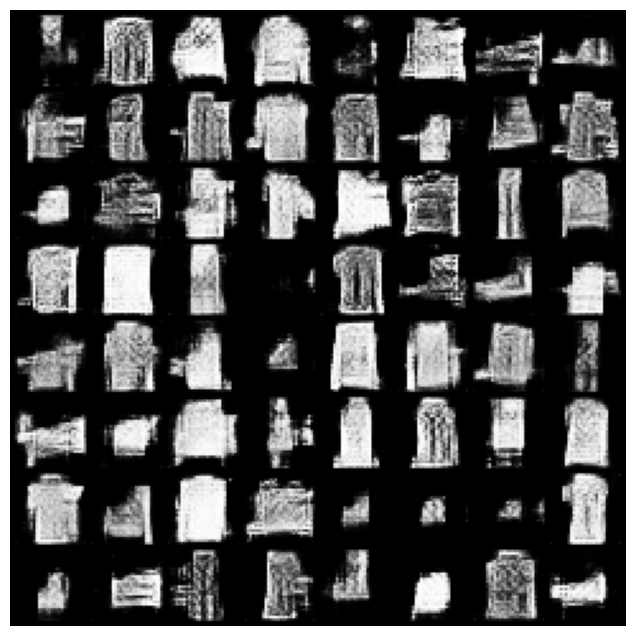

Epoch [19/50]: 100%|██████████| 938/938 [00:30<00:00, 30.38it/s]


Epoch [19/50] completed. D Loss: -0.008092522621154785, G Loss: -0.5657578110694885


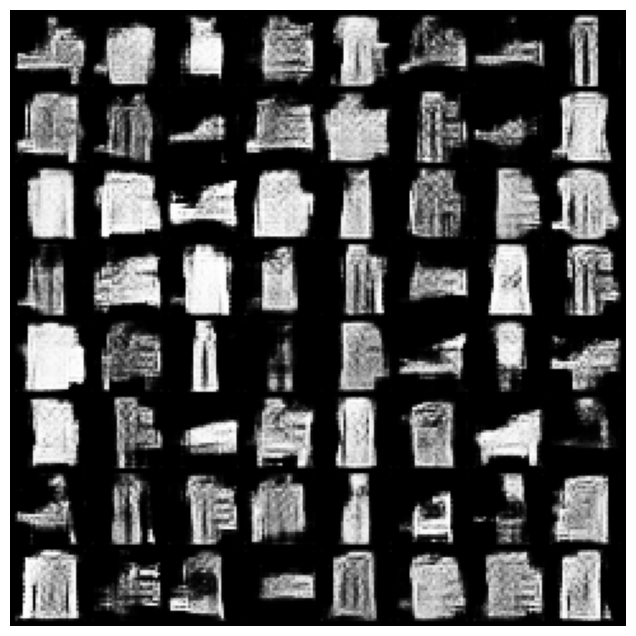

Epoch [20/50]: 100%|██████████| 938/938 [00:31<00:00, 30.01it/s]


Epoch [20/50] completed. D Loss: 0.0031892061233520508, G Loss: -0.5299515724182129


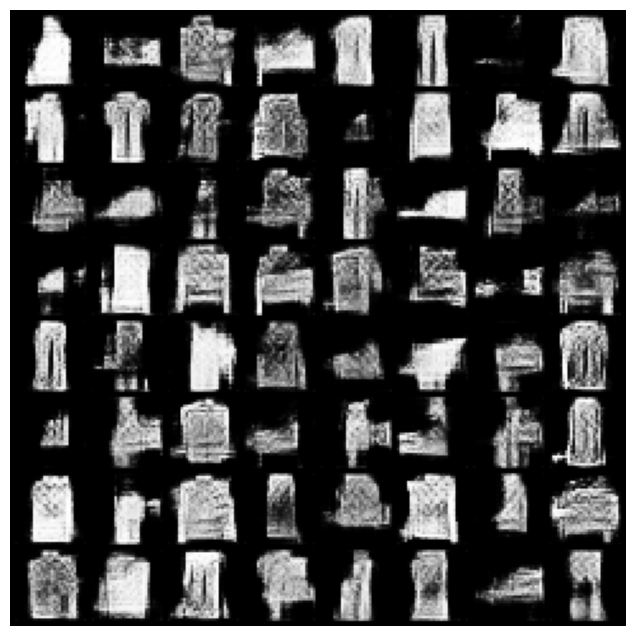

Epoch [21/50]: 100%|██████████| 938/938 [00:31<00:00, 29.94it/s]


Epoch [21/50] completed. D Loss: 0.004892110824584961, G Loss: -0.4351833462715149


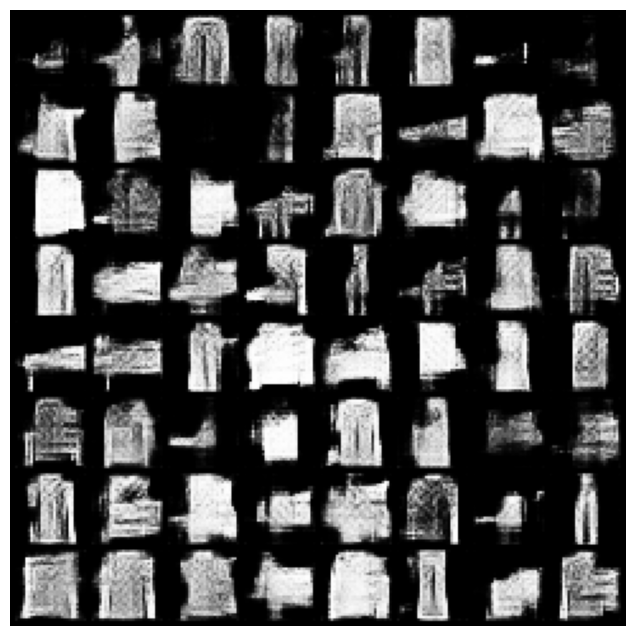

Epoch [22/50]: 100%|██████████| 938/938 [00:31<00:00, 30.20it/s]


Epoch [22/50] completed. D Loss: -0.006058454513549805, G Loss: -0.39551016688346863


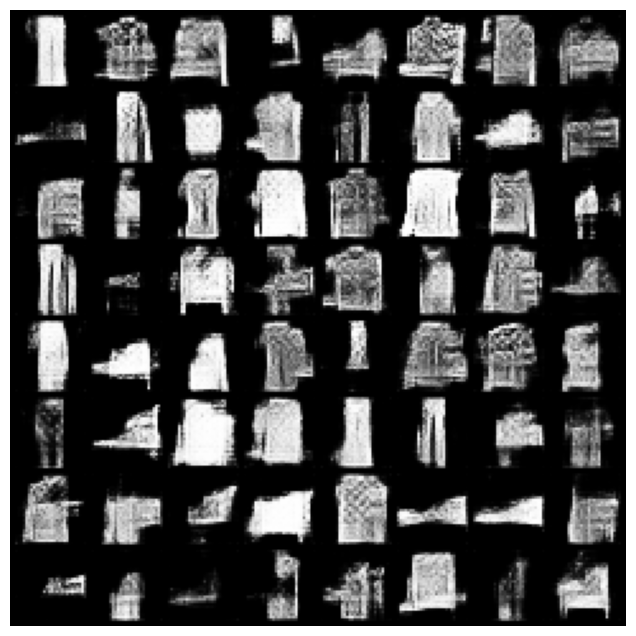

Epoch [23/50]: 100%|██████████| 938/938 [00:31<00:00, 30.20it/s]


Epoch [23/50] completed. D Loss: -0.009063005447387695, G Loss: -0.5251094102859497


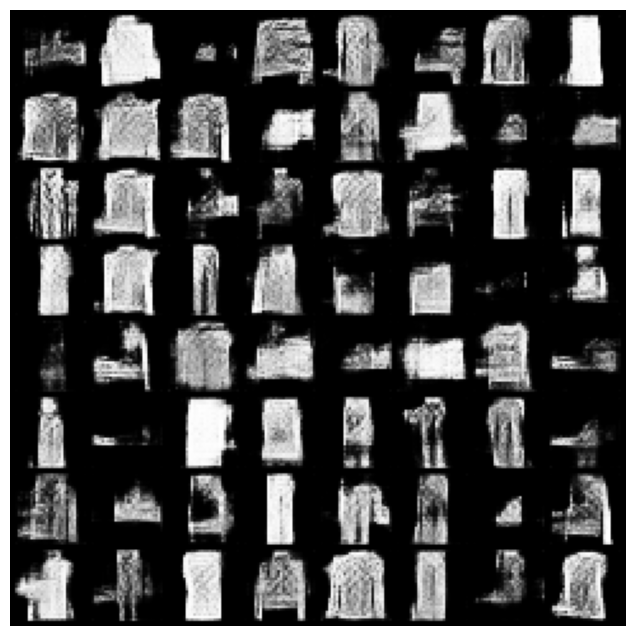

Epoch [24/50]: 100%|██████████| 938/938 [00:30<00:00, 30.63it/s]


Epoch [24/50] completed. D Loss: -0.010142266750335693, G Loss: -0.4950196146965027


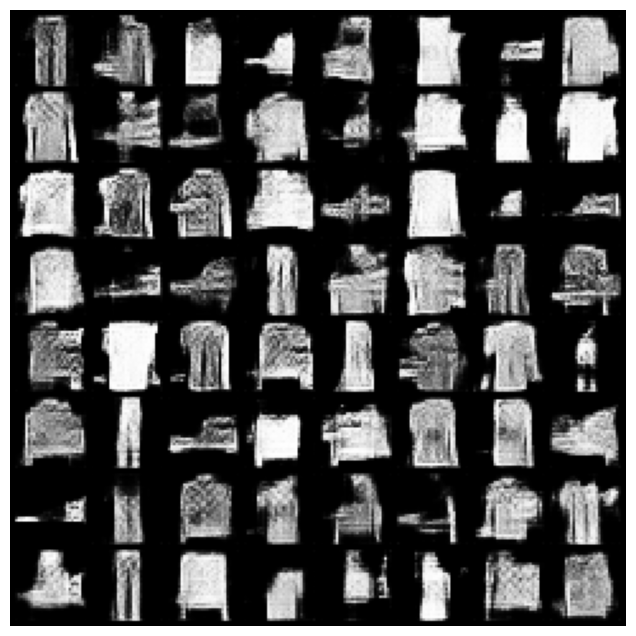

Epoch [25/50]: 100%|██████████| 938/938 [00:30<00:00, 30.35it/s]


Epoch [25/50] completed. D Loss: -0.027042269706726074, G Loss: -0.5792766809463501


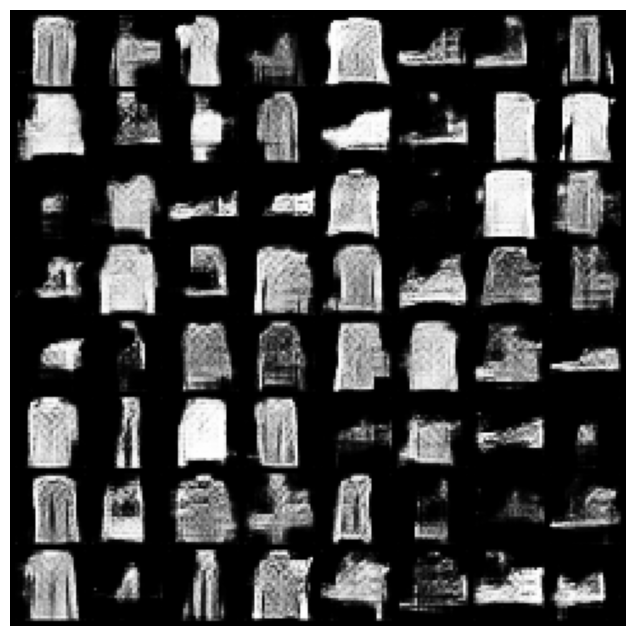

Epoch [26/50]: 100%|██████████| 938/938 [00:31<00:00, 30.25it/s]


Epoch [26/50] completed. D Loss: 0.00012725591659545898, G Loss: -0.49636000394821167


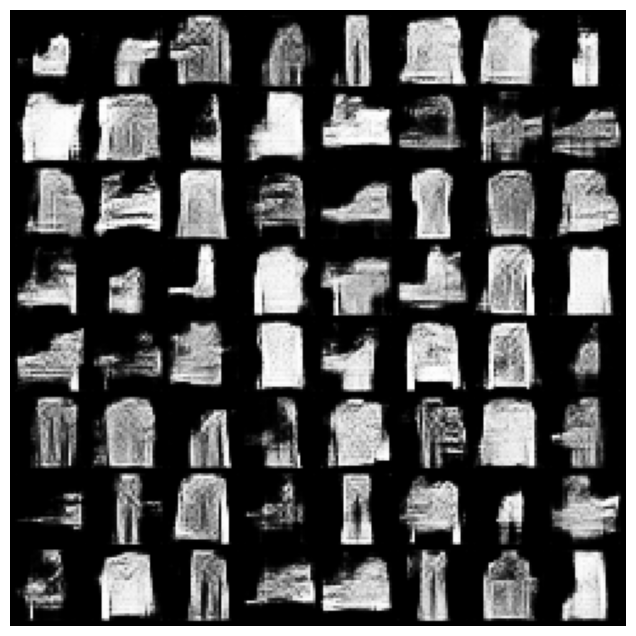

Epoch [27/50]: 100%|██████████| 938/938 [00:31<00:00, 29.78it/s]


Epoch [27/50] completed. D Loss: 0.015202701091766357, G Loss: -0.5676087141036987


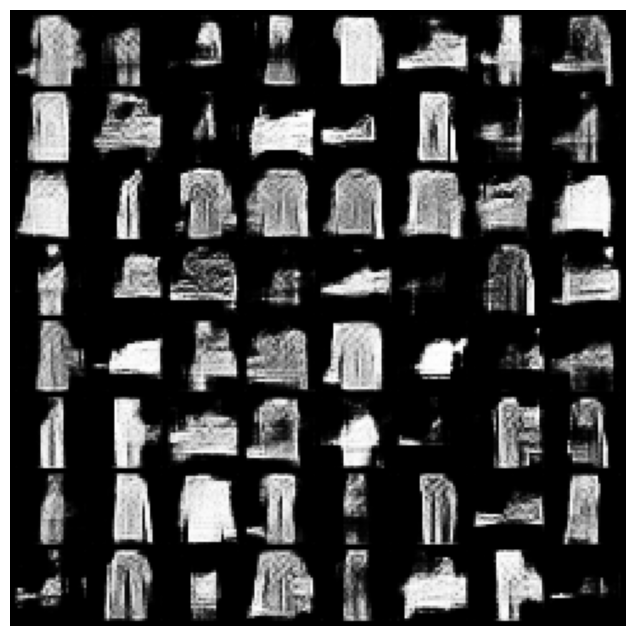

Epoch [28/50]: 100%|██████████| 938/938 [00:31<00:00, 29.77it/s]


Epoch [28/50] completed. D Loss: -0.007715582847595215, G Loss: -0.5140175223350525


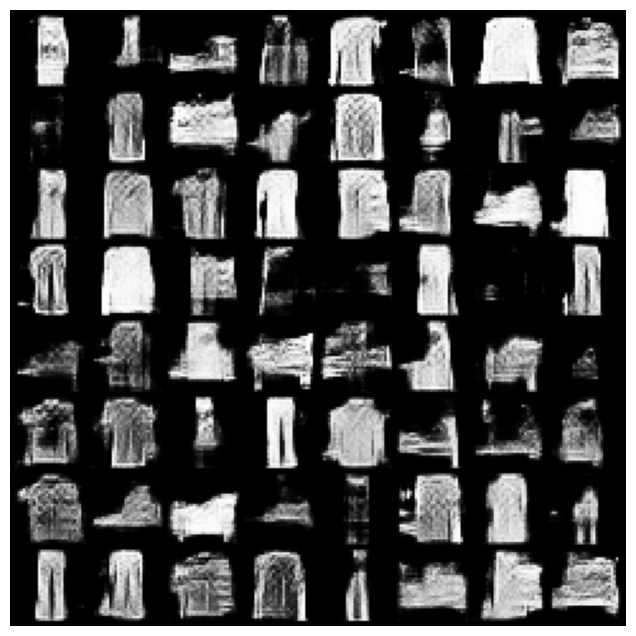

Epoch [29/50]: 100%|██████████| 938/938 [00:31<00:00, 29.87it/s]


Epoch [29/50] completed. D Loss: 0.012883126735687256, G Loss: -0.42642176151275635


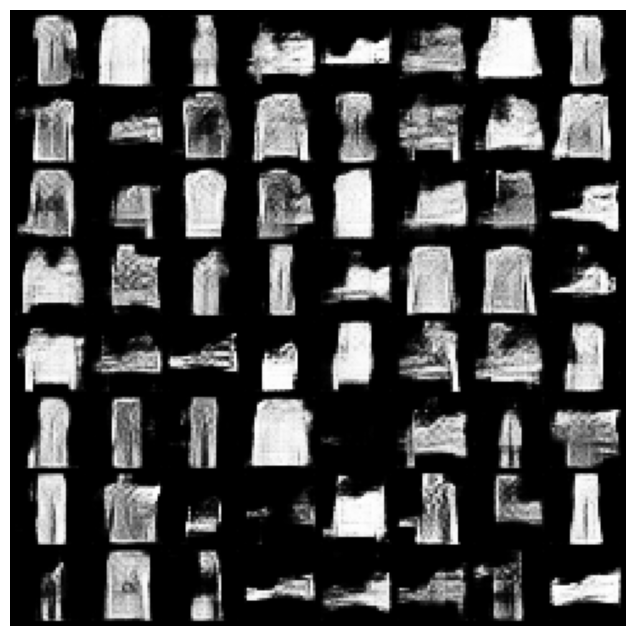

Epoch [30/50]: 100%|██████████| 938/938 [00:31<00:00, 30.16it/s]


Epoch [30/50] completed. D Loss: -0.0024010539054870605, G Loss: -0.494933545589447


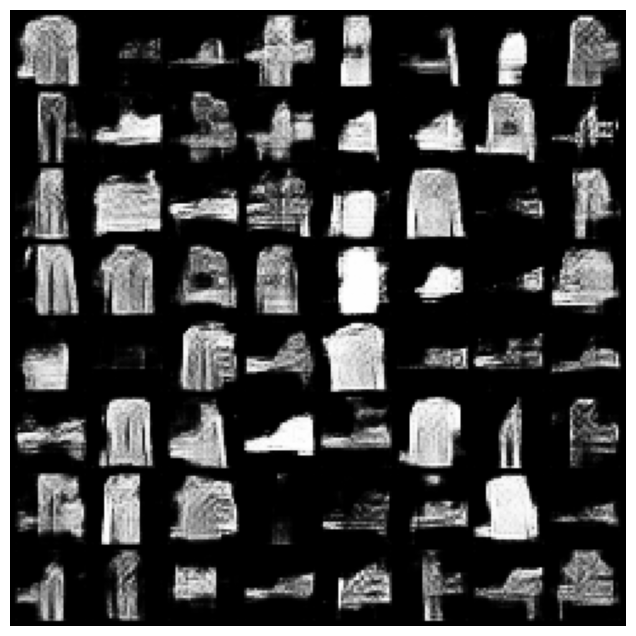

Epoch [31/50]: 100%|██████████| 938/938 [00:31<00:00, 29.86it/s]


Epoch [31/50] completed. D Loss: -0.0063502490520477295, G Loss: -0.4934920370578766


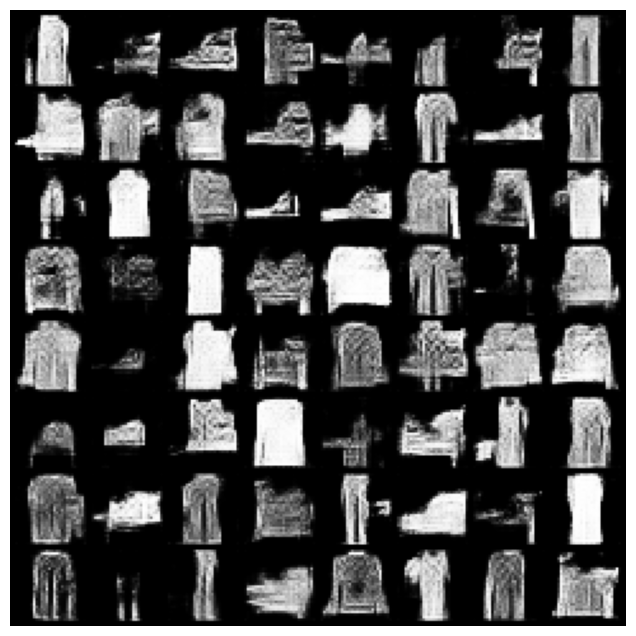

Epoch [32/50]: 100%|██████████| 938/938 [00:31<00:00, 30.04it/s]


Epoch [32/50] completed. D Loss: 0.013648182153701782, G Loss: -0.44869112968444824


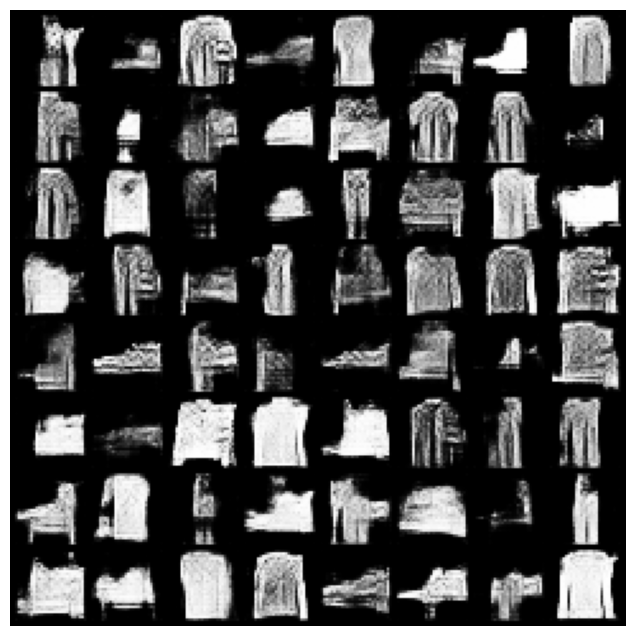

Epoch [33/50]: 100%|██████████| 938/938 [00:30<00:00, 30.31it/s]


Epoch [33/50] completed. D Loss: 0.012388944625854492, G Loss: -0.41906046867370605


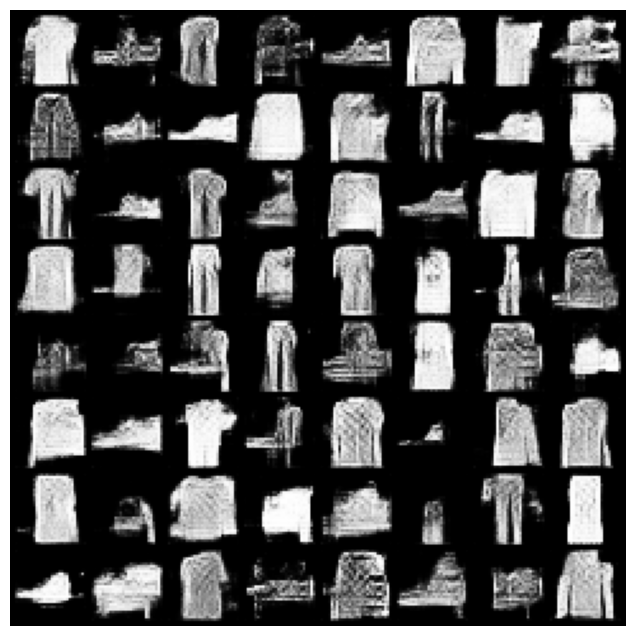

Epoch [34/50]: 100%|██████████| 938/938 [00:31<00:00, 29.78it/s]


Epoch [34/50] completed. D Loss: -0.0014810562133789062, G Loss: -0.45278528332710266


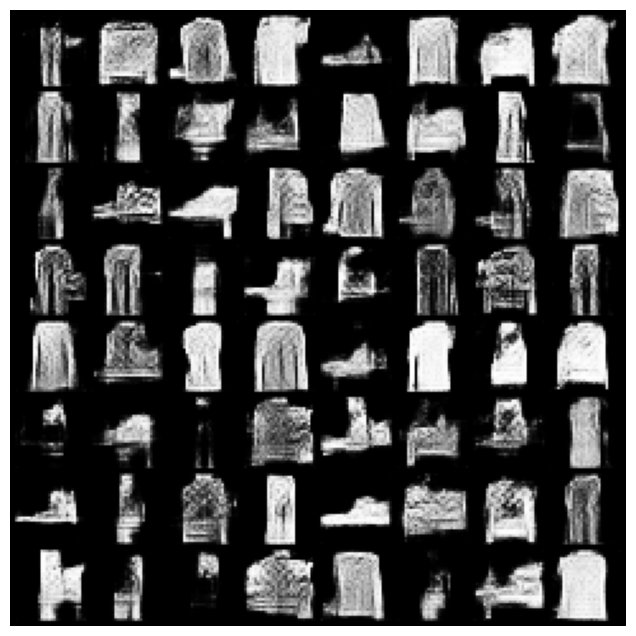

Epoch [35/50]: 100%|██████████| 938/938 [00:31<00:00, 29.76it/s]


Epoch [35/50] completed. D Loss: 0.024282991886138916, G Loss: -0.4390386939048767


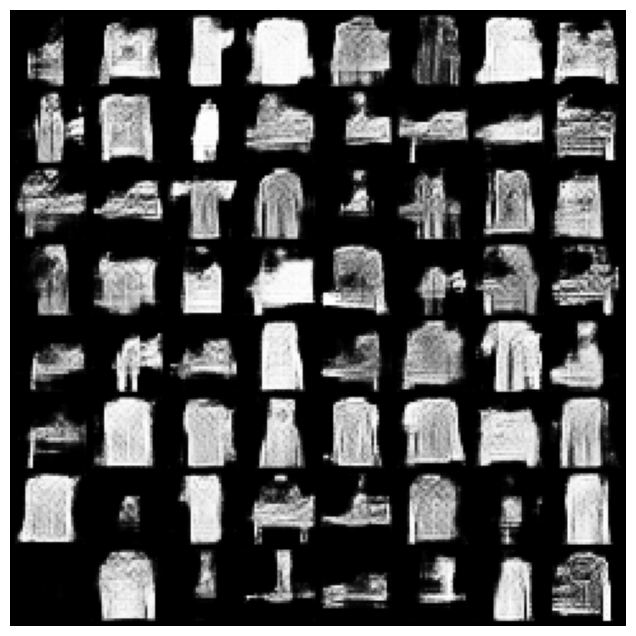

Epoch [36/50]: 100%|██████████| 938/938 [00:31<00:00, 30.09it/s]


Epoch [36/50] completed. D Loss: -0.005778521299362183, G Loss: -0.4948793947696686


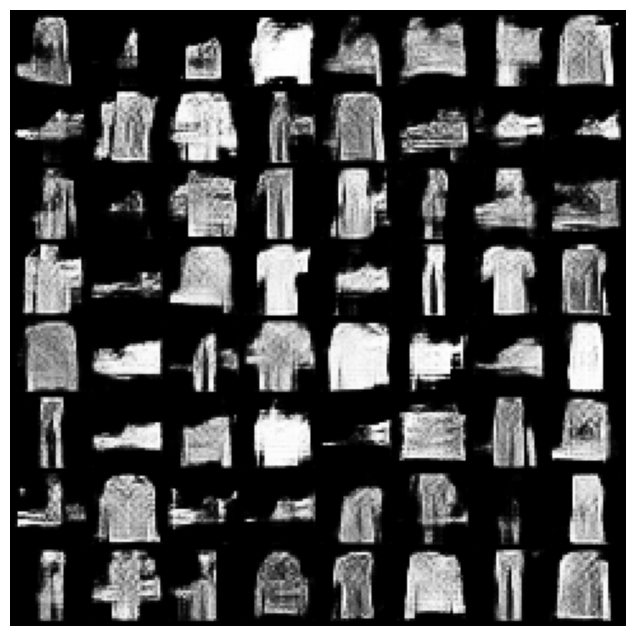

Epoch [37/50]: 100%|██████████| 938/938 [00:31<00:00, 30.05it/s]


Epoch [37/50] completed. D Loss: -0.034677594900131226, G Loss: -0.37970906496047974


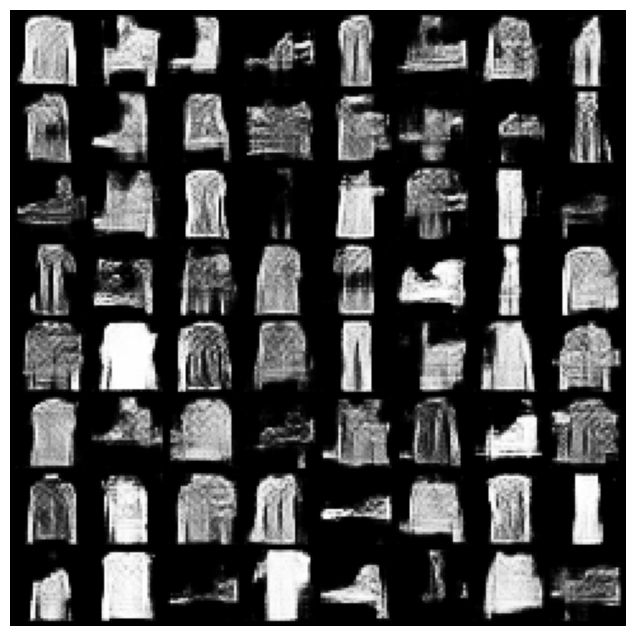

Epoch [38/50]: 100%|██████████| 938/938 [00:31<00:00, 30.10it/s]


Epoch [38/50] completed. D Loss: -0.029310166835784912, G Loss: -0.42491063475608826


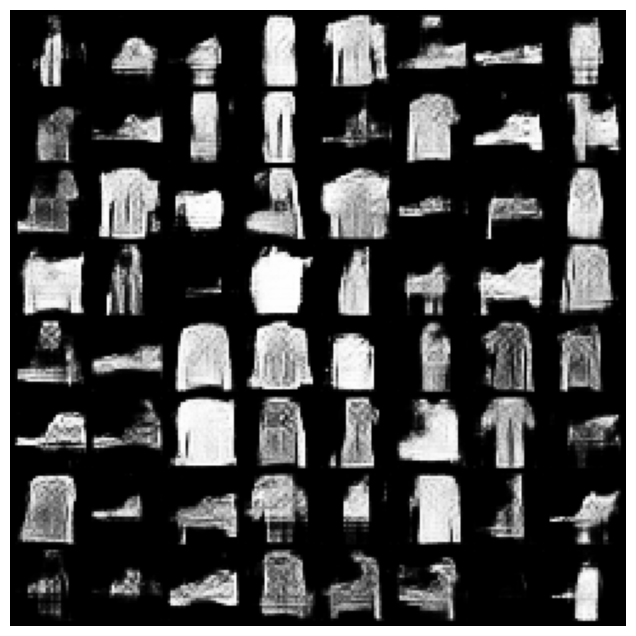

Epoch [39/50]: 100%|██████████| 938/938 [00:30<00:00, 30.30it/s]


Epoch [39/50] completed. D Loss: -0.0003847181797027588, G Loss: -0.39130234718322754


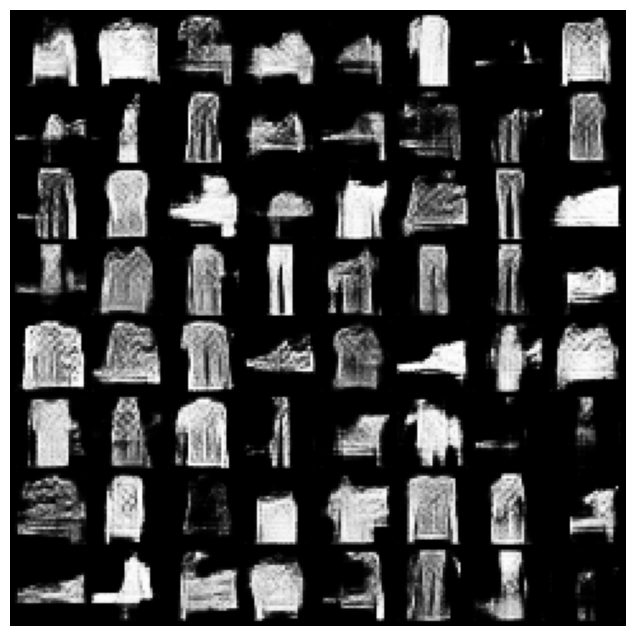

Epoch [40/50]: 100%|██████████| 938/938 [00:31<00:00, 29.83it/s]


Epoch [40/50] completed. D Loss: -0.004588186740875244, G Loss: -0.6235155463218689


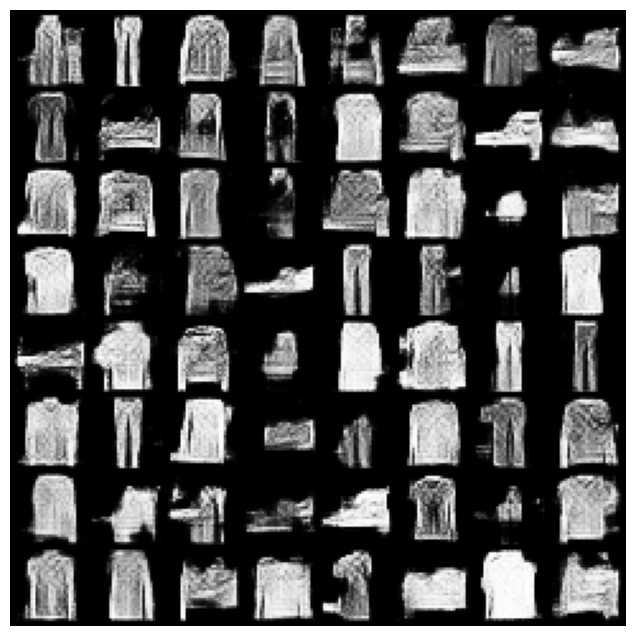

Epoch [41/50]: 100%|██████████| 938/938 [00:31<00:00, 30.24it/s]


Epoch [41/50] completed. D Loss: -0.005427956581115723, G Loss: -0.44441890716552734


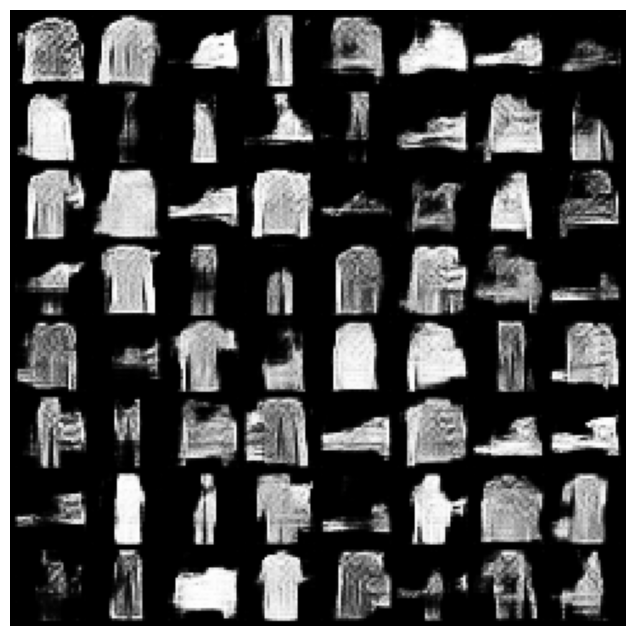

Epoch [42/50]: 100%|██████████| 938/938 [00:31<00:00, 30.14it/s]


Epoch [42/50] completed. D Loss: -0.007921993732452393, G Loss: -0.5045558214187622


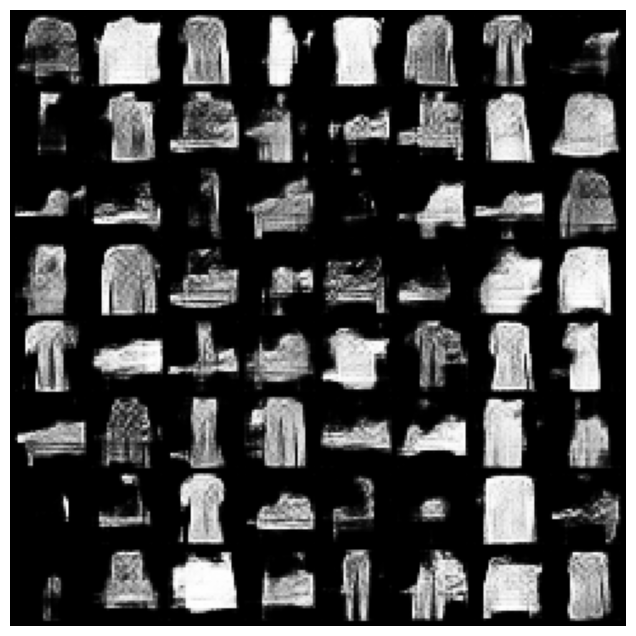

Epoch [43/50]: 100%|██████████| 938/938 [00:31<00:00, 30.13it/s]


Epoch [43/50] completed. D Loss: -0.016935288906097412, G Loss: -0.4547237753868103


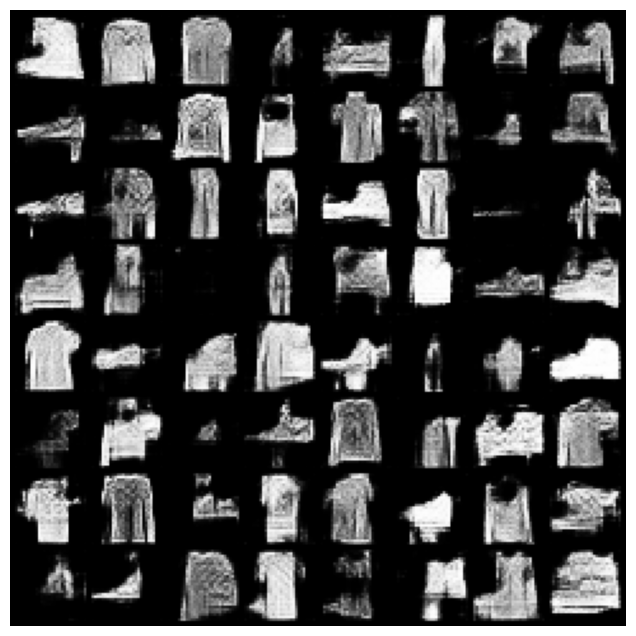

Epoch [44/50]: 100%|██████████| 938/938 [00:30<00:00, 30.28it/s]


Epoch [44/50] completed. D Loss: -0.008801072835922241, G Loss: -0.4759398400783539


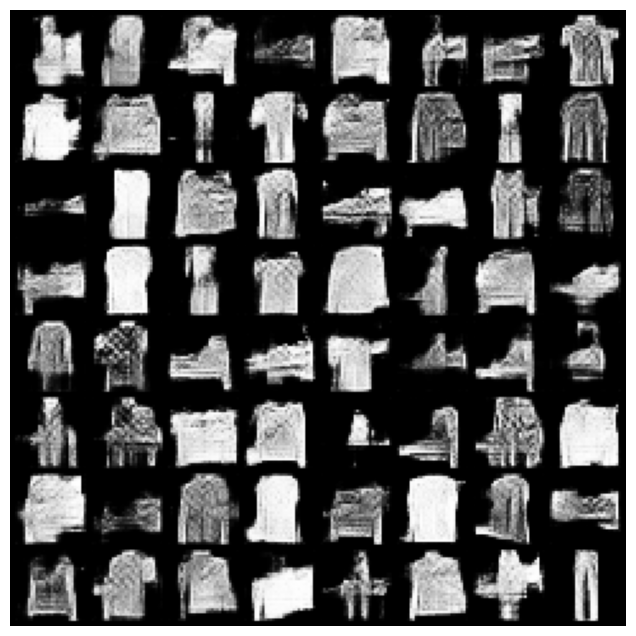

Epoch [45/50]: 100%|██████████| 938/938 [00:31<00:00, 29.72it/s]


Epoch [45/50] completed. D Loss: 0.0060485005378723145, G Loss: -0.412605345249176


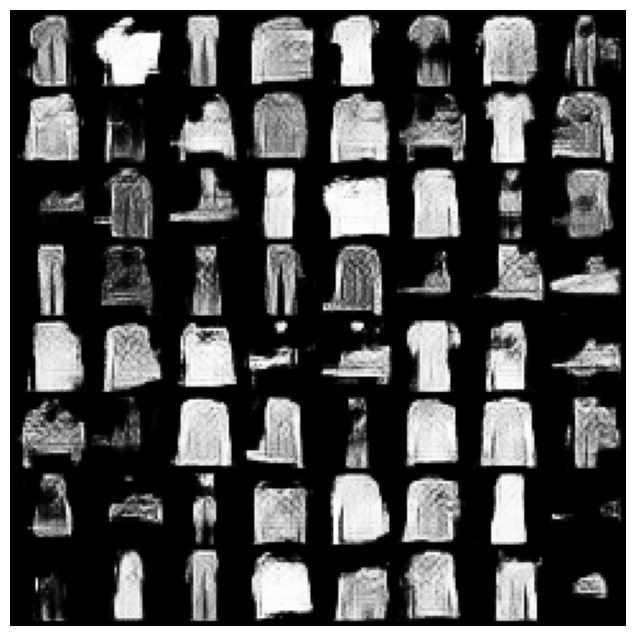

Epoch [46/50]: 100%|██████████| 938/938 [00:31<00:00, 29.95it/s]


Epoch [46/50] completed. D Loss: -0.021444261074066162, G Loss: -0.36134910583496094


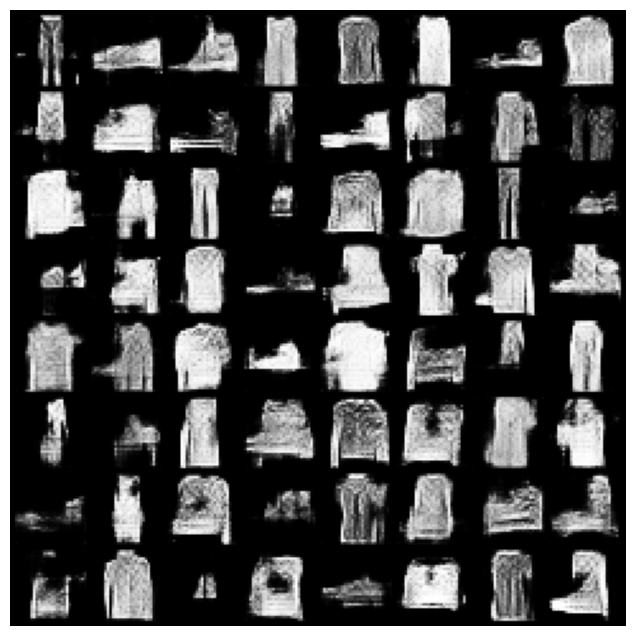

Epoch [47/50]: 100%|██████████| 938/938 [00:30<00:00, 30.27it/s]


Epoch [47/50] completed. D Loss: -0.005133509635925293, G Loss: -0.5227423906326294


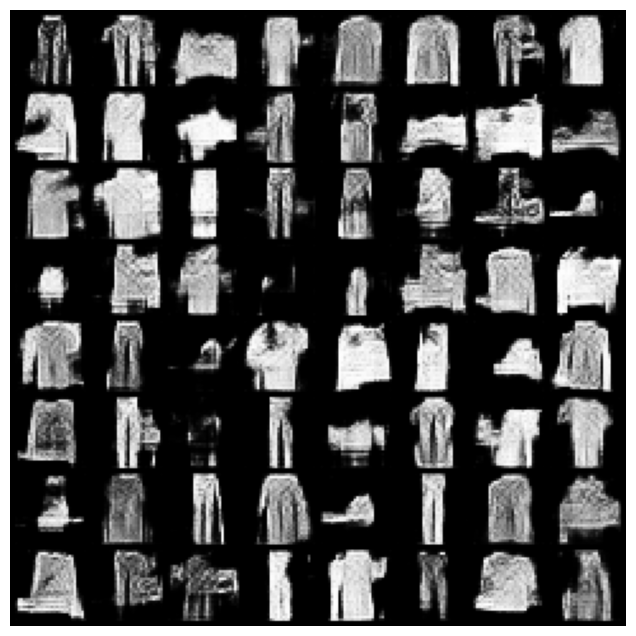

Epoch [48/50]: 100%|██████████| 938/938 [00:31<00:00, 30.11it/s]


Epoch [48/50] completed. D Loss: 0.001199483871459961, G Loss: -0.515745997428894


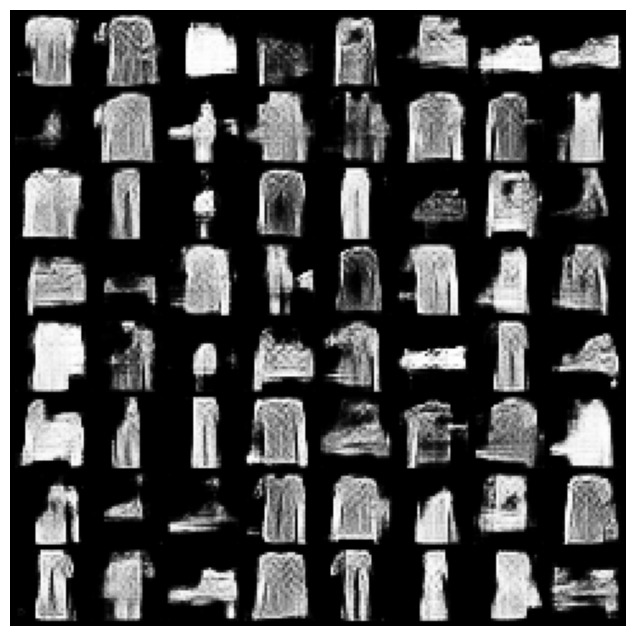

Epoch [49/50]: 100%|██████████| 938/938 [00:30<00:00, 30.30it/s]


Epoch [49/50] completed. D Loss: -0.024553626775741577, G Loss: -0.43967390060424805


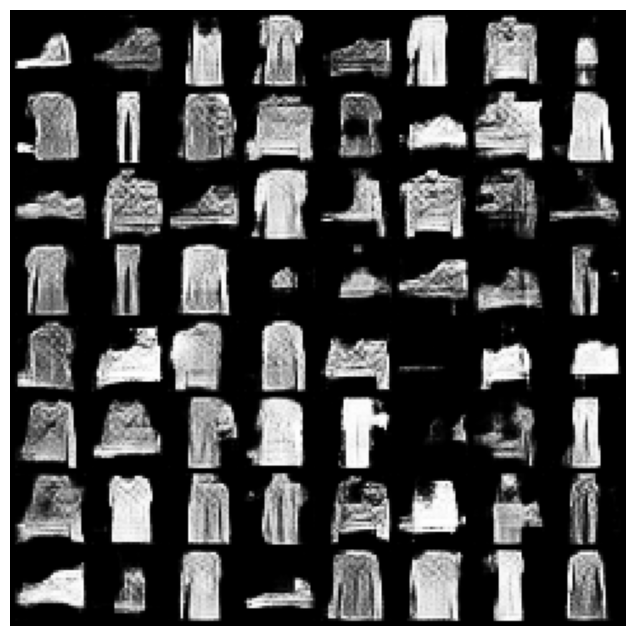

Epoch [50/50]: 100%|██████████| 938/938 [00:30<00:00, 30.27it/s]


Epoch [50/50] completed. D Loss: -0.005488365888595581, G Loss: -0.4379218816757202


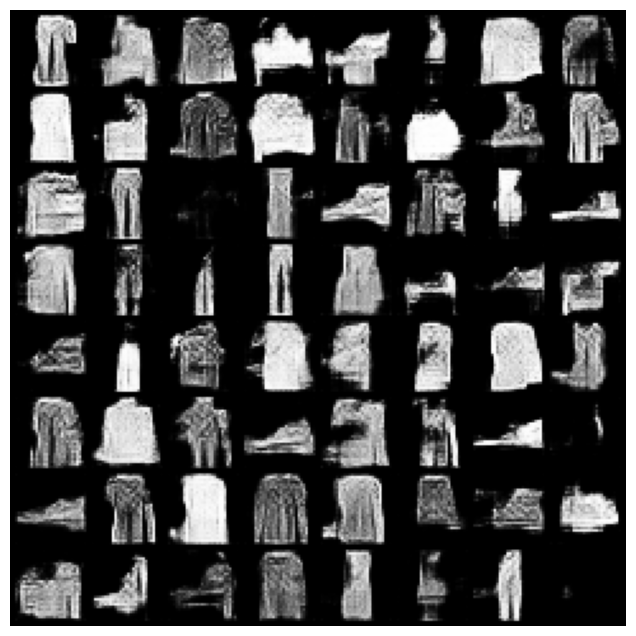

In [13]:
n_critic = 5  # Number of discriminator updates per generator update
clip_value = 0.01  # WGAN weight clipping

lrG = 5e-5  # Generator's learning rate
lrD = 5e-5  # Lower Discriminator's learning rate

# Initialize models
netG = Architecture_1_Generator().to(device)
netD = Architecture_1_Discriminator().to(device)

# Optimizers
optimizer_G = optim.RMSprop(netG.parameters(), lr=lrG)
optimizer_D = optim.RMSprop(netD.parameters(), lr=lrD)

G_losses = []
D_losses = []

num_epochs = 50

# Training loop
for epoch in range(num_epochs):
    for step, (real_imgs, _) in tqdm(enumerate(data_loader), total=len(data_loader), desc=f'Epoch [{epoch+1}/{num_epochs}]'):
        real_imgs = real_imgs.to(device)

        # Train Discriminator
        for _ in range(n_critic):
            optimizer_D.zero_grad()
            z = torch.randn(batch_size, 100).to(device)
            fake_imgs = netG(z)

            # Discriminator forward pass
            real_loss = -torch.mean(netD(real_imgs))  # Negative for WGAN
            fake_loss = torch.mean(netD(fake_imgs.detach()))

            # Total loss for Discriminator
            d_loss = real_loss + fake_loss
            d_loss.backward()
            optimizer_D.step()
            D_losses.append(d_loss.item())

            # Clip weights of discriminator (WGAN-specific)
            for p in netD.parameters():
                p.data.clamp_(-clip_value, clip_value)

        # Train Generator
        optimizer_G.zero_grad()
        z = torch.randn(batch_size, 100).to(device)
        fake_imgs = netG(z)

        # Generator forward pass
        g_loss = -torch.mean(netD(fake_imgs))  # Negative for WGAN
        g_loss.backward()
        optimizer_G.step()
        G_losses.append(g_loss.item())

    print(f"Epoch [{epoch+1}/{num_epochs}] completed. D Loss: {d_loss.item()}, G Loss: {g_loss.item()}")

    # Generate and visualize some images at the end of each epoch
    z = torch.randn(64, 100).to(device)
    gen_imgs = netG(z).detach().cpu()

    # Plot generated images
    grid_img = torchvision.utils.make_grid(gen_imgs, nrow=8, normalize=True)
    plt.figure(figsize=(8, 8))
    plt.imshow(grid_img.permute(1, 2, 0))
    plt.axis('off')
    plt.show()


    torch.save(netG.state_dict(), os.path.join(output_dir, 'WGAN_generator_last.pth'))
    torch.save(netD.state_dict(), os.path.join(output_dir, 'WGAN_discriminator_last.pth'))

# Generate some final images for visualization
z = torch.randn(64, 100).to(device)
final_images = netG(z).detach().cpu()

In [ ]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses, label="G Loss")
plt.plot(D_losses, label="D Loss")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

# WGAN-GP

In [ ]:
from torch.autograd import grad


n_critic = 5  # Number of discriminator updates per generator update
lambda_gp = 10  # Gradient penalty lambda value

# Initialize models
netG = Architecture_1_Generator().to(device)
netD = Architecture_1_Discriminator().to(device)

# Optimizers (using Adam for WGAN-GP)
optimizer_G = optim.Adam(netG.parameters(), lr=0.0002)
optimizer_D = optim.Adam(netD.parameters(), lr=0.0002)

# Function to compute gradient penalty
def compute_gradient_penalty(discriminator, real_data, fake_data):
    batch_size = real_data.size(0)
    alpha = torch.rand(batch_size, 1, 1, 1).to(device)  # Interpolation factor
    interpolates = (alpha * real_data + (1 - alpha) * fake_data).requires_grad_(True)

    # Pass the interpolated data through the discriminator
    disc_interpolates = discriminator(interpolates)

    # Compute gradients of interpolated data w.r.t. the discriminator's output
    gradients = grad(
        outputs=disc_interpolates, inputs=interpolates,
        grad_outputs=torch.ones(disc_interpolates.size()).to(device),
        create_graph=True, retain_graph=True, only_inputs=True
    )[0]

    # Compute the gradient penalty: (||grad||_2 - 1)^2
    gradients = gradients.view(batch_size, -1)
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()

    return gradient_penalty

# Training loop
for epoch in range(num_epochs):
    for step, (real_imgs, _) in tqdm(enumerate(data_loader), total=len(data_loader), desc=f'Epoch [{epoch+1}/{num_epochs}]'):
        real_imgs = real_imgs.to(device)

        # Train Discriminator
        for _ in range(n_critic):
            optimizer_D.zero_grad()

            # Generate fake images
            z = torch.randn(real_imgs.size(0), 100).to(device)
            fake_imgs = netG(z)

            # Discriminator forward pass on real and fake images
            real_loss = -torch.mean(netD(real_imgs))  # Negative for WGAN
            fake_loss = torch.mean(netD(fake_imgs.detach()))

            # Gradient penalty
            gradient_penalty = compute_gradient_penalty(netD, real_imgs, fake_imgs)

            # Total loss for the Discriminator (with gradient penalty)
            d_loss = real_loss + fake_loss + lambda_gp * gradient_penalty
            d_loss.backward()
            optimizer_D.step()

        d_loss = d_loss_real + d_loss_fake
        D_losses.append(d_loss.item())

        # Train Generator
        optimizer_G.zero_grad()
        z = torch.randn(real_imgs.size(0), 100).to(device)
        fake_imgs = netG(z)

        # Generator forward pass
        g_loss = -torch.mean(netD(fake_imgs))  # Negative for WGAN
        g_loss.backward()
        optimizer_G.step()
        G_losses.append(g_loss.item())

    print(f"Epoch [{epoch+1}/{num_epochs}] completed. D Loss: {d_loss.item()}, G Loss: {g_loss.item()}")

    # Generate and visualize some images at the end of each epoch
    z = torch.randn(64, 100).to(device)
    gen_imgs = netG(z).detach().cpu()

    # Plot generated images
    grid_img = torchvision.utils.make_grid(gen_imgs, nrow=8, normalize=True)
    plt.figure(figsize=(8, 8))
    plt.imshow(grid_img.permute(1, 2, 0), cmap='gray')
    plt.axis('off')
    plt.show()

    torch.save(netG.state_dict(), os.path.join(output_dir, 'WGAN-GP_generator_last.pth'))
    torch.save(netD.state_dict(), os.path.join(output_dir, 'WGAN-GP_discriminator_last.pth'))

# Generate some final images for visualization
z = torch.randn(64, 100).to(device)
final_images = netG(z).detach().cpu()

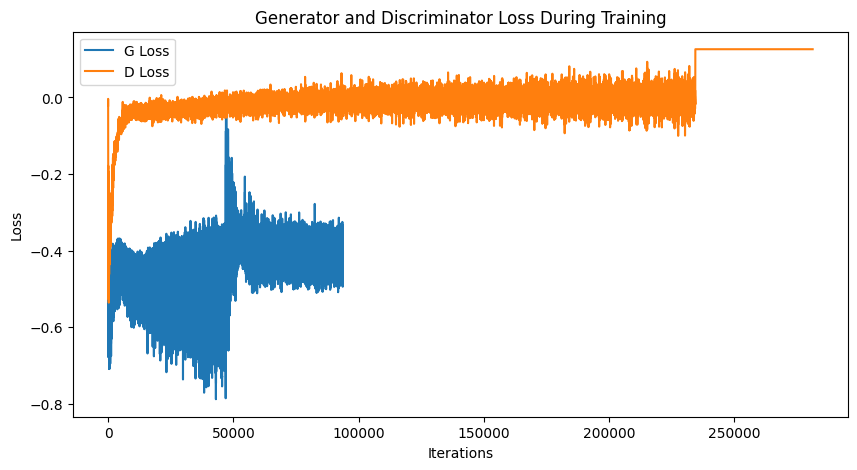

In [16]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses, label="G Loss")
plt.plot(D_losses, label="D Loss")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

# Architecture 2

In [ ]:
class Architecture_2_Generator(nn.Module):
    def __init__(self):
        super(Architecture_2_Generator, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(100, 128, 7, 1, 0, bias=False),
            nn.BatchNorm2d(128),  # Added BatchNorm
            nn.LeakyReLU(0.3),
            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),  # Added BatchNorm
            nn.LeakyReLU(0.3),
            nn.ConvTranspose2d(64, 1, 4, 2, 1, bias=False),
            nn.Tanh()  # Final activation to normalize output to [-1, 1]
        )

    def forward(self, z):
        z = z.view(-1, 100, 1, 1)  # Reshape for ConvTranspose2d
        return self.model(z)

class Architecture_2_Discriminator(nn.Module):
    def __init__(self):
        super(Architecture_2_Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(1, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),  # Added BatchNorm
            nn.ReLU(),
            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),  # Added BatchNorm
            nn.ReLU(),
            nn.Conv2d(128, 1, 7, 1, 0, bias=False),
            nn.Sigmoid()  # Output for real/fake classification
        )

    def forward(self, img):
        return self.model(img).view(-1, 1)  # Reshape to (batch_size, 1)

# DCGAN

In [ ]:
lrG = 1e-3  # Generator's learning rate
lrD = 1e-3  # Lower Discriminator's learning rate

# Initialize the models
netG = Architecture_2_Generator()
netD = Architecture_2_Discriminator()

# Loss function and optimizers
criterion = nn.BCELoss()  # Binary Cross Entropy Loss for real/fake classification
optimizerD = optim.Adam(netD.parameters(), lr=lrD, betas=(0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lrG, betas=(0.5, 0.999))

# Hyperparameters
batch_size = 64
num_epochs = 50
n_critic = 1  # Number of discriminator updates per generator update

# Loss and optimizers
criterion = nn.BCELoss()
optimizer_G = optim.Adam(netG.parameters(), lr=lrG)
optimizer_D = optim.Adam(netD.parameters(), lr=lrD)

# Training
for epoch in range(num_epochs):
    with tqdm(total=len(data_loader), desc=f'Epoch [{epoch+1}/{num_epochs}]', unit='batch') as pbar:
        for imgs, _ in data_loader:
            batch_size = imgs.size(0)

            # Labels
            real_labels = torch.ones(batch_size, 1)
            fake_labels = torch.zeros(batch_size, 1)

            # Train Discriminator n_critic times
            for _ in range(n_critic):
                optimizer_D.zero_grad()
                outputs = netD(imgs)
                d_loss_real = criterion(outputs, real_labels)
                d_loss_real.backward()

                z = torch.randn(batch_size, 100)
                fake_imgs = netG(z)
                outputs = netD(fake_imgs.detach())
                d_loss_fake = criterion(outputs, fake_labels)
                d_loss_fake.backward()
                optimizer_D.step()

            d_loss = d_loss_real + d_loss_fake
            D_losses.append(d_loss.item())

            # Train Generator
            optimizer_G.zero_grad()
            outputs = netD(fake_imgs)
            g_loss = criterion(outputs, real_labels)
            g_loss.backward()
            optimizer_G.step()
            G_losses.append(g_loss.item())

            # Update progress bar
            pbar.update(1)
            pbar.set_postfix(d_loss=d_loss_real.item() + d_loss_fake.item(), g_loss=g_loss.item())

    # Generate and visualize images at the end of each epoch
    z = torch.randn(64, 100)
    generated_imgs = netG(z).detach().cpu()
    grid_img = torchvision.utils.make_grid(generated_imgs, nrow=8, normalize=True)

    plt.figure(figsize=(8, 8))
    plt.imshow(grid_img.permute(1, 2, 0).numpy(), cmap='gray')
    plt.axis('off')
    plt.title(f'Epoch {epoch+1}')
    plt.show()

    torch.save(netG.state_dict(), os.path.join(output_dir, 'DCGAN2_generator_last.pth'))
    torch.save(netD.state_dict(), os.path.join(output_dir, 'DCGAN2_discriminator_last.pth'))

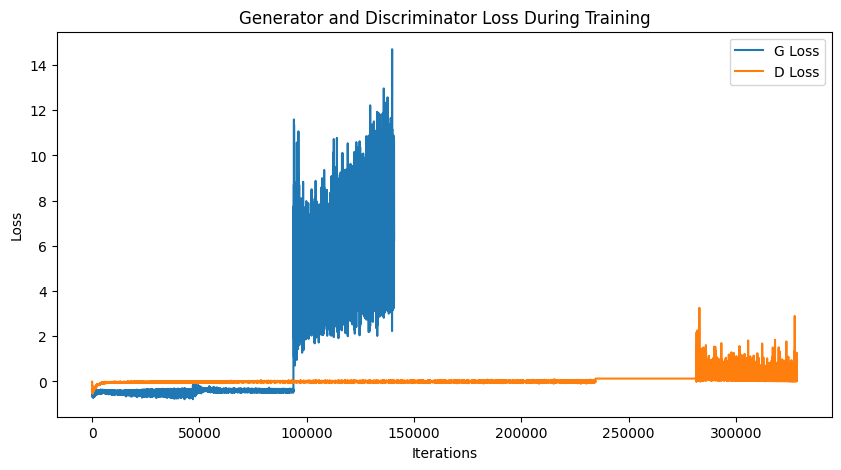

In [19]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses, label="G Loss")
plt.plot(D_losses, label="D Loss")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

# WGAN

In [ ]:
n_critic = 5  # Number of discriminator updates per generator update
clip_value = 0.01  # WGAN weight clipping

# Initialize models
netG = Architecture_2_Generator().to(device)
netD = Architecture_2_Discriminator().to(device)

# Optimizers
optimizer_G = optim.RMSprop(netG.parameters(), lr=lrG)
optimizer_D = optim.RMSprop(netD.parameters(), lr=lrD)

# Training loop
for epoch in range(num_epochs):
    for step, (real_imgs, _) in tqdm(enumerate(data_loader), total=len(data_loader), desc=f'Epoch [{epoch+1}/{num_epochs}]'):
        real_imgs = real_imgs.to(device)

        # Train Discriminator
        for _ in range(n_critic):
            optimizer_D.zero_grad()
            z = torch.randn(batch_size, 100).to(device)
            fake_imgs = netG(z)

            # Discriminator forward pass
            real_loss = -torch.mean(netD(real_imgs))  # Negative for WGAN
            fake_loss = torch.mean(netD(fake_imgs.detach()))

            # Total loss for Discriminator
            d_loss = real_loss + fake_loss
            d_loss.backward()
            optimizer_D.step()
            D_losses.append(d_loss.item())

            # Clip weights of discriminator (WGAN-specific)
            for p in netD.parameters():
                p.data.clamp_(-clip_value, clip_value)

        # Train Generator
        optimizer_G.zero_grad()
        z = torch.randn(batch_size, 100).to(device)
        fake_imgs = netG(z)

        # Generator forward pass
        g_loss = -torch.mean(netD(fake_imgs))  # Negative for WGAN
        g_loss.backward()
        optimizer_G.step()
        G_losses.append(g_loss.item())

    print(f"Epoch [{epoch+1}/{num_epochs}] completed. D Loss: {d_loss.item()}, G Loss: {g_loss.item()}")

    # Generate and visualize some images at the end of each epoch
    z = torch.randn(64, 100).to(device)
    gen_imgs = netG(z).detach().cpu()

    # Plot generated images
    grid_img = torchvision.utils.make_grid(gen_imgs, nrow=8, normalize=True)
    plt.figure(figsize=(8, 8))
    plt.imshow(grid_img.permute(1, 2, 0))
    plt.axis('off')
    plt.show()

    torch.save(netG.state_dict(), os.path.join(output_dir, 'WGAN2_generator_last.pth'))
    torch.save(netD.state_dict(), os.path.join(output_dir, 'WGAN2_discriminator_last.pth'))

# Generate some final images for visualization
z = torch.randn(64, 100).to(device)
final_images = netG(z).detach().cpu()

In [ ]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses, label="G Loss")
plt.plot(D_losses, label="D Loss")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

# WGAN-GP

In [ ]:
n_critic = 5  # Number of discriminator updates per generator update
lambda_gp = 10  # Gradient penalty lambda value

# Initialize models
netG = Architecture_1_Generator().to(device)
netD = Architecture_1_Discriminator().to(device)

# Optimizers (using Adam for WGAN-GP)
optimizer_G = optim.Adam(netG.parameters(), lr=0.0002)
optimizer_D = optim.Adam(netD.parameters(), lr=0.0002)

# Function to compute gradient penalty
def compute_gradient_penalty(discriminator, real_data, fake_data):
    batch_size = real_data.size(0)
    alpha = torch.rand(batch_size, 1, 1, 1).to(device)  # Interpolation factor
    interpolates = (alpha * real_data + (1 - alpha) * fake_data).requires_grad_(True)

    # Pass the interpolated data through the discriminator
    disc_interpolates = discriminator(interpolates)

    # Compute gradients of interpolated data w.r.t. the discriminator's output
    gradients = grad(
        outputs=disc_interpolates, inputs=interpolates,
        grad_outputs=torch.ones(disc_interpolates.size()).to(device),
        create_graph=True, retain_graph=True, only_inputs=True
    )[0]

    # Compute the gradient penalty: (||grad||_2 - 1)^2
    gradients = gradients.view(batch_size, -1)
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()

    return gradient_penalty

# Training loop
for epoch in range(num_epochs):
    for step, (real_imgs, _) in tqdm(enumerate(data_loader), total=len(data_loader), desc=f'Epoch [{epoch+1}/{num_epochs}]'):
        real_imgs = real_imgs.to(device)

        # Train Discriminator
        for _ in range(n_critic):
            optimizer_D.zero_grad()

            # Generate fake images
            z = torch.randn(real_imgs.size(0), 100).to(device)
            fake_imgs = netG(z)

            # Discriminator forward pass on real and fake images
            real_loss = -torch.mean(netD(real_imgs))  # Negative for WGAN
            fake_loss = torch.mean(netD(fake_imgs.detach()))

            # Gradient penalty
            gradient_penalty = compute_gradient_penalty(netD, real_imgs, fake_imgs)

            # Total loss for the Discriminator (with gradient penalty)
            d_loss = real_loss + fake_loss + lambda_gp * gradient_penalty
            d_loss.backward()
            optimizer_D.step()

        d_loss = d_loss_real + d_loss_fake
        D_losses.append(d_loss.item())

        # Train Generator
        optimizer_G.zero_grad()
        z = torch.randn(real_imgs.size(0), 100).to(device)
        fake_imgs = netG(z)

        # Generator forward pass
        g_loss = -torch.mean(netD(fake_imgs))  # Negative for WGAN
        g_loss.backward()
        optimizer_G.step()
        G_losses.append(g_loss.item())

    print(f"Epoch [{epoch+1}/{num_epochs}] completed. D Loss: {d_loss.item()}, G Loss: {g_loss.item()}")

    # Generate and visualize some images at the end of each epoch
    z = torch.randn(64, 100).to(device)
    gen_imgs = netG(z).detach().cpu()

    # Plot generated images
    grid_img = torchvision.utils.make_grid(gen_imgs, nrow=8, normalize=True)
    plt.figure(figsize=(8, 8))
    plt.imshow(grid_img.permute(1, 2, 0), cmap='gray')
    plt.axis('off')
    plt.show()

    torch.save(netG.state_dict(), os.path.join(output_dir, 'WGAN-GP2_generator_last.pth'))
    torch.save(netD.state_dict(), os.path.join(output_dir, 'WGAN-GP2_discriminator_last.pth'))

# Generate some final images for visualization
z = torch.randn(64, 100).to(device)
final_images = netG(z).detach().cpu()

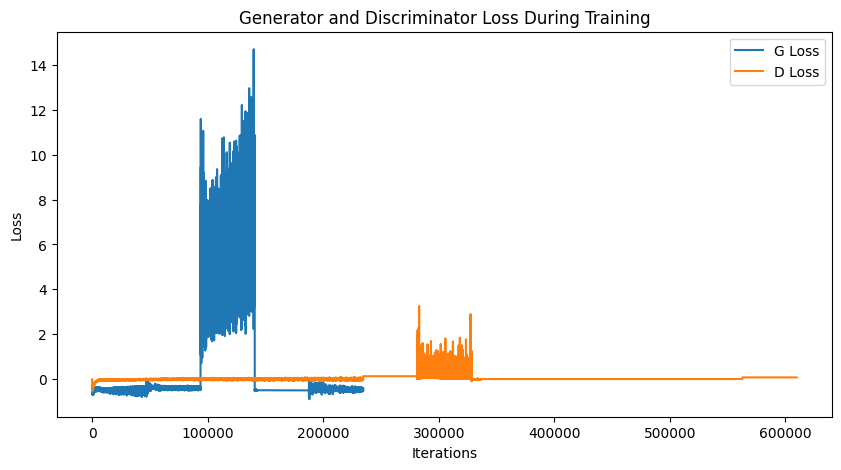

In [23]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses, label="G Loss")
plt.plot(D_losses, label="D Loss")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [ ]:
import torch
import matplotlib.pyplot as plt
from torchvision import transforms
from PIL import Image
import numpy as np

# Load your trained generator models for each method
# Assuming models are defined and trained as dcgan, wgan, wgan_gp
# Also assuming they are already loaded in your environment

# Function to generate images from the generator
def generate_images(generator, num_images, label):
    noise = torch.randn(num_images, 100)  # Adjust size based on your noise vector
    with torch.no_grad():
        generated_images = generator(noise).detach().cpu()
    return generated_images

# Number of images to generate
num_images = 2  # For T-shirt and Dress, we'll generate two for each method

# Generate images for T-shirt
tshirt_images_dcgan = generate_images(dcgan_generator, num_images, 'T-shirt')
tshirt_images_wgan = generate_images(wgan_generator, num_images, 'T-shirt')
tshirt_images_wgan_gp = generate_images(wgan_gp_generator, num_images, 'T-shirt')

# Generate images for Dress
dress_images_dcgan = generate_images(dcgan_generator, num_images, 'Dress')
dress_images_wgan = generate_images(wgan_generator, num_images, 'Dress')
dress_images_wgan_gp = generate_images(wgan_gp_generator, num_images, 'Dress')

# Load real images from Fashion MNIST dataset (ensure you have the paths)
real_images_tshirt = [Image.open('path/to/tshirt_image1.png'), Image.open('path/to/tshirt_image2.png')]
real_images_dress = [Image.open('path/to/dress_image1.png'), Image.open('path/to/dress_image2.png')]

# Function to display images
def display_images(images, title):
    plt.figure(figsize=(10, 5))
    for i, img in enumerate(images):
        img = img.numpy().transpose(1, 2, 0)  # Convert to HWC format
        plt.subplot(1, len(images), i + 1)
        plt.imshow((img * 0.5 + 0.5))  # Rescale to [0, 1] if using Tanh activation
        plt.axis('off')
    plt.suptitle(title)
    plt.show()

# Display all images
# Real T-shirt images
display_images(real_images_tshirt, 'Real T-shirts')

# Generated T-shirt images
display_images(tshirt_images_dcgan, 'DCGAN T-shirts')
display_images(tshirt_images_wgan, 'WGAN T-shirts')
display_images(tshirt_images_wgan_gp, 'WGAN-GP T-shirts')

# Real Dress images
display_images(real_images_dress, 'Real Dresses')

# Generated Dress images
display_images(dress_images_dcgan, 'DCGAN Dresses')
display_images(dress_images_wgan, 'WGAN Dresses')
display_images(dress_images_wgan_gp, 'WGAN-GP Dresses')
